##### Copyright 2018 The TensorFlow Authors.


In [ ]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

<style>
td {
  text-align: center;
}

th {
  text-align: center;
}
</style>

# Image captioning with visual attention

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/text/tutorials/image_captioning"><img src="https://www.tensorflow.org/images/tf_logo_32px.png" />View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/text/blob/master/docs/tutorials/image_captioning.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/text/blob/master/docs/tutorials/image_captioning.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/text/docs/tutorials/image_captioning.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
</table>

Given an image like the example below, your goal is to generate a
caption such as "a surfer riding on a wave".

<table style="text-align: center;">
<tr>
  <td>
   <img src="https://tensorflow.org/images/surf.jpg"/>
  </td>
</tr>
<tr>
  <th>A man surfing, from <a href=https://commons.wikimedia.org/wiki/Surfing#/media/File:Surfing_in_Hawaii.jpg>wikimedia</a></th>
</tr>
</table>

The model architecture used here is inspired by [Show, Attend and Tell: Neural Image Caption Generation with Visual Attention](https://arxiv.org/abs/1502.03044), but has been updated to use a 2-layer Transformer-decoder. To get the most out of this tutorial you should have some experience with [text generation](https://www.tensorflow.org/text/tutorials/text_generation),  [seq2seq models & attention](https://www.tensorflow.org/text/tutorials/nmt_with_attention), or [transformers](https://www.tensorflow.org/text/tutorials/transformer).

The model architecture built in this tutorial is shown below. Features are extracted from the image, and passed to the cross-attention layers of the Transformer-decoder.

<table>
<tr>
  <th>The model architecture</th>
</tr>
<tr>
  <td>
   <img width=400 src="https://tensorflow.org/images/tutorials/transformer/ImageCaptioning.png"/>
  </td>
</tr>
</table>

The transformer decoder is mainly built from attention layers. It uses self-attention to process the sequence being generated, and it uses cross-attention to attend to the image.

By inspecting the attention weights of the cross attention layers you will see what parts of the image the model is looking at as it generates words.

![Prediction](https://tensorflow.org/images/imcap_prediction.png)

This notebook is an end-to-end example. When you run the notebook, it downloads a dataset, extracts and caches the image features, and trains a decoder model. It then uses the model to generate captions on new images.

## Setup

In [ ]:
!pip install einops==0.7.0 tensorflow_text==2.15.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 495.4 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 23.8 MB/s eta 0:00:00


This tutorial uses lots of imports, mostly for loading the dataset(s).

In [ ]:
#@title
import concurrent.futures
import collections
import dataclasses
import hashlib
import itertools
import json
import math
import os
import pathlib
import random
import re
import string
import time
import urllib.request

import einops
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import requests
import tqdm

import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
import tensorflow_datasets as tfds

## [Optional] Data handling

This section downloads a captions dataset and prepares it for training. It tokenizes the input text, and caches the results of running all the images through a pretrained feature-extractor model. It's not critical to understand everything in this section.

 <section class="expandable tfo-display-only-on-site">
 <button type="button" class="button-red button expand-control">Toggle section</button>


### Choose a dataset

This tutorial is set up to give a choice of datasets. Either [Flickr8k](https://www.ijcai.org/Proceedings/15/Papers/593.pdf) or a small slice of the [Conceptual Captions](https://ai.google.com/research/ConceptualCaptions/) dataset. These two are downloaded and converted from scratch, but it wouldn't be hard to convert the tutorial to use the caption datasets available in [TensorFlow Datasets](https://www.tensorflow.org/datasets): [Coco Captions](https://www.tensorflow.org/datasets/catalog/coco_captions) and the full [Conceptual Captions](https://www.tensorflow.org/datasets/community_catalog/huggingface/conceptual_captions).


#### Flickr8k

In [ ]:
def flickr8k(path='flickr8k'):
  path = pathlib.Path(path)

  if len(list(path.rglob('*'))) < 16197:
    tf.keras.utils.get_file(
        origin='https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip',
        cache_dir='.',
        cache_subdir=path,
        extract=True)
    tf.keras.utils.get_file(
        origin='https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip',
        cache_dir='.',
        cache_subdir=path,
        extract=True)

  captions = (path/"Flickr8k.token.txt").read_text().splitlines()
  captions = (line.split('\t') for line in captions)
  captions = ((fname.split('#')[0], caption) for (fname, caption) in captions)

  cap_dict = collections.defaultdict(list)
  for fname, cap in captions:
    cap_dict[fname].append(cap)

  train_files = (path/'Flickr_8k.trainImages.txt').read_text().splitlines()
  train_captions = [(str(path/'Flicker8k_Dataset'/fname), cap_dict[fname]) for fname in train_files]

  test_files = (path/'Flickr_8k.testImages.txt').read_text().splitlines()
  test_captions = [(str(path/'Flicker8k_Dataset'/fname), cap_dict[fname]) for fname in test_files]

  train_ds = tf.data.experimental.from_list(train_captions)
  test_ds = tf.data.experimental.from_list(test_captions)

  return train_ds, test_ds

#### Conceptual Captions

In [ ]:
def conceptual_captions(*, data_dir="conceptual_captions", num_train, num_val):
  def iter_index(index_path):
    with open(index_path) as f:
      for line in f:
        caption, url = line.strip().split('\t')
        yield caption, url

  def download_image_urls(data_dir, urls):
    ex = concurrent.futures.ThreadPoolExecutor(max_workers=100)
    def save_image(url):
      hash = hashlib.sha1(url.encode())
      # Name the files after the hash of the URL.
      file_path = data_dir/f'{hash.hexdigest()}.jpeg'
      if file_path.exists():
        # Only download each file once.
        return file_path

      try:
        result = requests.get(url, timeout=5)
      except Exception:
        file_path = None
      else:
        file_path.write_bytes(result.content)
      return file_path

    result = []
    out_paths = ex.map(save_image, urls)
    for file_path in tqdm.tqdm(out_paths, total=len(urls)):
      result.append(file_path)

    return result

  def ds_from_index_file(index_path, data_dir, count):
    data_dir.mkdir(exist_ok=True)
    index = list(itertools.islice(iter_index(index_path), count))
    captions = [caption for caption, url in index]
    urls = [url for caption, url in index]

    paths = download_image_urls(data_dir, urls)

    new_captions = []
    new_paths = []
    for cap, path in zip(captions, paths):
      if path is None:
        # Download failed, so skip this pair.
        continue
      new_captions.append(cap)
      new_paths.append(path)

    new_paths = [str(p) for p in new_paths]

    ds = tf.data.Dataset.from_tensor_slices((new_paths, new_captions))
    ds = ds.map(lambda path,cap: (path, cap[tf.newaxis])) # 1 caption per image
    return ds

  data_dir = pathlib.Path(data_dir)
  train_index_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/gcc-data/Train/GCC-training.tsv',
    cache_subdir=data_dir,
    cache_dir='.')

  val_index_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/gcc-data/Validation/GCC-1.1.0-Validation.tsv',
    cache_subdir=data_dir,
    cache_dir='.')

  train_raw = ds_from_index_file(train_index_path, data_dir=data_dir/'train', count=num_train)
  test_raw = ds_from_index_file(val_index_path, data_dir=data_dir/'val', count=num_val)

  return train_raw, test_raw

#### Download the dataset

The Flickr8k is a good choice because it contains 5-captions per image, more data for a smaller download.

In [ ]:
choose = 'flickr8k'

if choose == 'flickr8k':
  train_raw, test_raw = flickr8k()
else:
  train_raw, test_raw = conceptual_captions(num_train=10000, num_val=5000)

2340801/2340801 [==============================] - 0s 0us/step


The loaders for both datasets above return `tf.data.Dataset`s containing `(image_path, captions)` pairs. The Flickr8k dataset contains 5 captions per image, while Conceptual Captions has 1:

In [ ]:
train_raw.element_spec

(TensorSpec(shape=(), dtype=tf.string, name=None),
 TensorSpec(shape=(5,), dtype=tf.string, name=None))

In [ ]:
for ex_path, ex_captions in train_raw.take(1):
  print(ex_path)
  print(ex_captions)

tf.Tensor(b'flickr8k/Flicker8k_Dataset/2513260012_03d33305cf.jpg', shape=(), dtype=string)
tf.Tensor(
[b'A black dog is running after a white dog in the snow .'
 b'Black dog chasing brown dog through snow'
 b'Two dogs chase each other across the snowy ground .'
 b'Two dogs play together in the snow .'
 b'Two dogs running through a low lying body of water .'], shape=(5,), dtype=string)


### Image feature extractor

You will use an image model (pretrained on imagenet) to extract the features from each image. The model was trained as an image classifier, but setting `include_top=False` returns the model without the final classification layer, so you can use the last layer of feature-maps:  


In [ ]:
import tensorflow as tf

IMAGE_SHAPE=(224, 224, 3)
mobilenet = tf.keras.applications.efficientnet_v2.EfficientNetV2L(
    input_shape=IMAGE_SHAPE,
    include_top=False,
    weights='imagenet',
    include_preprocessing=True)
mobilenet.trainable=False

473176280/473176280 [==============================] - 12s 0us/step


Here's a function to load an image and resize it for the model:

In [ ]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.io.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, IMAGE_SHAPE[:-1])
    img = tf.image.convert_image_dtype(img, tf.float32)
    return img

In [ ]:
test_img_batch = load_image('flickr8k/Flicker8k_Dataset/2513260012_03d33305cf.jpg')[tf.newaxis, :]

print(test_img_batch.shape)
print(mobilenet(test_img_batch).shape) # (1, 7, 7, 576)

(1, 224, 224, 3)
(1, 7, 7, 1280)


### Setup the text tokenizer/vectorizer

You will transform the text captions into integer sequences using the [TextVectorization](https://www.tensorflow.org/api_docs/python/tf/keras/layers/TextVectorization) layer, with the following steps:

* Use [adapt](https://www.tensorflow.org/api_docs/python/tf/keras/layers/TextVectorization#adapt) to iterate over all captions, split the captions into words, and compute a vocabulary of the top words.
* Tokenize all captions by mapping each word to its index in the vocabulary. All output sequences will be padded to length 50.
* Create word-to-index and index-to-word mappings to display results.

In [ ]:
def standardize(s):
  s = tf.strings.lower(s)
  s = tf.strings.regex_replace(s, f'[{re.escape(string.punctuation)}]', '')
  s = tf.strings.join(['[START]', s, '[END]'], separator=' ')
  return s

In [ ]:
# Use the top 5000 words for a vocabulary.
vocabulary_size = 5000
tokenizer = tf.keras.layers.TextVectorization(
    max_tokens=vocabulary_size,
    standardize=standardize,
    ragged=True)
# Learn the vocabulary from the caption data.

In [ ]:
tokenizer.adapt(train_raw.map(lambda fp,txt: txt).unbatch().batch(1024))

In [ ]:
tokenizer.get_vocabulary()[:10]

['', '[UNK]', 'a', '[START]', '[END]', 'in', 'the', 'on', 'is', 'and']

In [ ]:
t = tokenizer([['a cat in a hat'], ['a robot dog']])
t

<tf.RaggedTensor [[3, 2, 655, 5, 2, 97, 4], [3, 2, 1937, 10, 4]]>

In [ ]:
# Create mappings for words to indices and indices to words.
word_to_index = tf.keras.layers.StringLookup(
    mask_token="",
    vocabulary=tokenizer.get_vocabulary())
index_to_word = tf.keras.layers.StringLookup(
    mask_token="",
    vocabulary=tokenizer.get_vocabulary(),
    invert=True)

In [ ]:
w = index_to_word(t)
w.to_list()

[[b'[START]', b'a', b'cat', b'in', b'a', b'hat', b'[END]'],
 [b'[START]', b'a', b'robot', b'dog', b'[END]']]

In [ ]:
tf.strings.reduce_join(w, separator=' ', axis=-1).numpy()

array([b'[START] a cat in a hat [END]', b'[START] a robot dog [END]'],
      dtype=object)

In [ ]:
word_to_index('cat').numpy()

655

In [ ]:
word_to_index('.').numpy() # [UNK]

1

### Prepare the datasets

The `train_raw` and `test_raw` datasets contain 1:many `(image, captions)` pairs.

This function will replicate the image so there are 1:1 images to captions:

In [ ]:
def match_shapes(images, captions):
  caption_shape = einops.parse_shape(captions, 'b c')
  captions = einops.rearrange(captions, 'b c -> (b c)')
  images = einops.repeat(
      images, 'b ... -> (b c) ...',
      c = caption_shape['c'])
  return images, captions

In [ ]:
for ex_paths, ex_captions in train_raw.batch(32).take(1):
  break

print('image paths:', ex_paths.shape)
print('captions:', ex_captions.shape)
print()

ex_paths, ex_captions = match_shapes(images=ex_paths, captions=ex_captions)

print('image_paths:', ex_paths.shape)
print('captions:', ex_captions.shape)


image paths: (32,)
captions: (32, 5)

image_paths: (160,)
captions: (160,)


To be compatible with keras training the dataset should contain `(inputs, labels)` pairs. For text generation the tokens are both an input and the labels, shifted by one step. This function will convert an `(images, texts)` pair to an `((images, input_tokens), label_tokens)` pair:

In [ ]:
def prepare_txt(imgs, txts):
  tokens = tokenizer(txts)

  input_tokens = tokens[..., :-1]
  label_tokens = tokens[..., 1:]
  return (imgs, input_tokens), label_tokens

This function adds operations to a dataset. The steps are:

1. Load the images (and ignore images that fail to load).
2. Replicate images to match the number of captions.
3. Shuffle and rebatch the `image, caption` pairs.
4. Tokenize the text, shift the tokens and add `label_tokens`.
5. Convert the text from a `RaggedTensor` representation to padded dense `Tensor` representation.

In [ ]:
def prepare_dataset(ds, tokenizer, batch_size=32, shuffle_buffer=1000):
  # Load the images and make batches.
  ds = (ds
        .shuffle(10000)
        .map(lambda path, caption: (load_image(path), caption))
        .apply(tf.data.experimental.ignore_errors())
        .batch(batch_size))

  def to_tensor(inputs, labels):
    (images, in_tok), out_tok = inputs, labels
    return (images, in_tok.to_tensor()), out_tok.to_tensor()

  return (ds
          .map(match_shapes, tf.data.AUTOTUNE)
          .unbatch()
          .shuffle(shuffle_buffer)
          .batch(batch_size)
          .map(prepare_txt, tf.data.AUTOTUNE)
          .map(to_tensor, tf.data.AUTOTUNE)
          )

You could install the feature extractor in your model and train on the datasets like this:

In [ ]:
train_ds = prepare_dataset(train_raw, tokenizer)
train_ds.element_spec

Instructions for updating:
Use `tf.data.Dataset.ignore_errors` instead.


((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, None), dtype=tf.int64, name=None)),
 TensorSpec(shape=(None, None), dtype=tf.int64, name=None))

In [ ]:
test_ds = prepare_dataset(test_raw, tokenizer)
test_ds.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, None), dtype=tf.int64, name=None)),
 TensorSpec(shape=(None, None), dtype=tf.int64, name=None))

### [Optional] Cache the image features

Since the image feature extractor is not changing, and this tutorial is not using image augmentation, the image features can be cached. Same for the text tokenization. The time it takes to set up the cache is earned back on each epoch during training and validation. The code below defines two functions `save_dataset` and `load_dataset`:

In [ ]:
def save_dataset(ds, save_path, image_model, tokenizer, shards=10, batch_size=32):
  # Load the images and make batches.
  ds = (ds
        .map(lambda path, caption: (load_image(path), caption))
        .apply(tf.data.experimental.ignore_errors())
        .batch(batch_size))

  # Run the feature extractor on each batch
  # Don't do this in a .map, because tf.data runs on the CPU.
  def gen():
    for (images, captions) in tqdm.tqdm(ds):
      feature_maps = image_model(images)

      feature_maps, captions = match_shapes(feature_maps, captions)
      yield feature_maps, captions

  # Wrap the generator in a new tf.data.Dataset.
  new_ds = tf.data.Dataset.from_generator(
      gen,
      output_signature=(
          tf.TensorSpec(shape=image_model.output_shape),
          tf.TensorSpec(shape=(None,), dtype=tf.string)))

  # Apply the tokenization
  new_ds = (new_ds
            .map(prepare_txt, tf.data.AUTOTUNE)
            .unbatch()
            .shuffle(1000))

  # Save the dataset into shard files.
  def shard_func(i, item):
    return i % shards
  new_ds.enumerate().save(save_path, shard_func=shard_func)

def load_dataset(save_path, batch_size=32, shuffle=1000, cycle_length=2):
  def custom_reader_func(datasets):
    datasets = datasets.shuffle(1000)
    return datasets.interleave(lambda x: x, cycle_length=cycle_length)

  ds = tf.data.Dataset.load(save_path, reader_func=custom_reader_func)

  def drop_index(i, x):
    return x

  ds = (ds
        .map(drop_index, tf.data.AUTOTUNE)
        .shuffle(shuffle)
        .padded_batch(batch_size)
        .prefetch(tf.data.AUTOTUNE))
  return ds

In [ ]:
save_dataset(train_raw, 'train_cache', mobilenet, tokenizer)
save_dataset(test_raw, 'test_cache', mobilenet, tokenizer)

188it [02:58,  1.05it/s]
32it [00:30,  1.06it/s]


 </section>


## Data ready for training

After those preprocessing steps, here are the datasets:

In [ ]:
train_ds = load_dataset('train_cache')
test_ds = load_dataset('test_cache')

In [ ]:
train_ds.element_spec

((TensorSpec(shape=(None, 7, 7, 1280), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, None), dtype=tf.int64, name=None)),
 TensorSpec(shape=(None, None), dtype=tf.int64, name=None))

The dataset now returns `(input, label)` pairs suitable for training with keras. The `inputs` are `(images, input_tokens)` pairs. The `images` have been processed with the feature-extractor model. For each location in the `input_tokens` the model looks at the text so far and tries to predict the next which is lined up at the same location in the `labels`.

In [ ]:
for (inputs, ex_labels) in train_ds.take(1):
  (ex_img, ex_in_tok) = inputs

print(ex_img.shape)
print(ex_in_tok.shape)
print(ex_labels.shape)

(32, 7, 7, 1280)
(32, 22)
(32, 22)


The input tokens and the labels are the same, just shifted by 1 step:

In [ ]:
print(ex_in_tok[0].numpy())
print(ex_labels[0].numpy())

[  3   2  12 119   6 209 121  13   2 114   0   0   0   0   0   0   0   0
   0   0   0   0]
[  2  12 119   6 209 121  13   2 114   4   0   0   0   0   0   0   0   0
   0   0   0   0]


## A Transformer decoder model

This model assumes that the pretrained image encoder is sufficient, and just focuses on building the text decoder. This tutorial uses a 2-layer Transformer-decoder.

The implementations are almost identical to those in the [Transformers tutorial](https://www.tensorflow.org/text/tutorials/transformer). Refer back to it for more details.

<table>
<tr>
  <th>The Transformer encoder and decoder.</th>
</tr>
<tr>
  <td>
   <img width=400 src="https://www.tensorflow.org/images/tutorials/transformer/Transformer-1layer-words.png"/>
  </td>
</tr>
</table>

The model will be implemented in three main parts:

1. Input - The token embedding and positional encoding (`SeqEmbedding`).
1. Decoder - A stack of transformer decoder layers (`DecoderLayer`) where each contains:
   1. A causal self attention later (`CausalSelfAttention`), where each output location can attend to the output so far.
   1. A cross attention layer (`CrossAttention`) where each output location can attend to the input image.
   1. A feed forward network (`FeedForward`) layer which further processes each output location independently.
1. Output - A multiclass-classification over the output vocabulary.


### Input

The input text has already been split up into tokens and converted to sequences of IDs.

Remember that unlike a CNN or RNN the Transformer's attention layers are invariant to the order of the sequence. Without some positional input, it just sees an unordered set not a sequence. So in addition to a simple vector embedding for each token ID, the embedding layer will also include an embedding for each position in the sequence.

The `SeqEmbedding` layer defined below:

- It looks up the embedding vector for each token.
- It looks up an embedding vector for each sequence location.
- It adds the two together.
- It uses `mask_zero=True` to initialize the keras-masks for the model.

Note: This implementation learns the position embeddings instead of using fixed embeddings like in the [Transformer tutorial](https://www.tensorflow.org/text/tutorials/transformer). Learning the embeddings is slightly less code, but doesn't generalize to longer sequences.

In [ ]:
import tensorflow as tf
class SeqEmbedding(tf.keras.layers.Layer):
  def __init__(self, vocab_size, max_length, depth):
    super().__init__()
    self.pos_embedding = tf.keras.layers.Embedding(input_dim=max_length, output_dim=depth)

    self.token_embedding = tf.keras.layers.Embedding(
        input_dim=vocab_size,
        output_dim=depth,
        mask_zero=True)

    self.add = tf.keras.layers.Add()

  def call(self, seq):
    seq = self.token_embedding(seq) # (batch, seq, depth)

    x = tf.range(tf.shape(seq)[1])  # (seq)
    x = x[tf.newaxis, :]  # (1, seq)
    x = self.pos_embedding(x)  # (1, seq, depth)

    return self.add([seq,x])

### Decoder

The decoder is a standard Transformer-decoder, it contains a stack of `DecoderLayers` where each contains three sublayers: a `CausalSelfAttention`, a `CrossAttention`, and a`FeedForward`. The implementations are almost identical to the [Transformer tutorial](https://www.tensorflow.org/text/tutorials/transformer), refer to it for more details.

The `CausalSelfAttention` layer is below:

In [ ]:
import tensorflow as tf
class CausalSelfAttention(tf.keras.layers.Layer):
  def __init__(self, **kwargs):
    super().__init__()
    self.mha = tf.keras.layers.MultiHeadAttention(**kwargs)
    # Use Add instead of + so the keras mask propagates through.
    self.add = tf.keras.layers.Add()
    self.layernorm = tf.keras.layers.LayerNormalization()

  def call(self, x):
    attn = self.mha(query=x, value=x,
                    use_causal_mask=True)
    x = self.add([x, attn])
    return self.layernorm(x)


The `CrossAttention` layer is below. Note the use of `return_attention_scores`.

In [ ]:
class CrossAttention(tf.keras.layers.Layer):
  def __init__(self,**kwargs):
    super().__init__()
    self.mha = tf.keras.layers.MultiHeadAttention(**kwargs)
    self.add = tf.keras.layers.Add()
    self.layernorm = tf.keras.layers.LayerNormalization()

  def call(self, x, y, **kwargs):
    attn, attention_scores = self.mha(
             query=x, value=y,
             return_attention_scores=True)

    self.last_attention_scores = attention_scores

    x = self.add([x, attn])
    return self.layernorm(x)

The `FeedForward` layer is below. Remember that a `layers.Dense` layer is applied to the last axis of the input. The input will have a shape of `(batch, sequence, channels)`, so it automatically applies pointwise across the `batch` and `sequence` axes.  

In [ ]:
class FeedForward(tf.keras.layers.Layer):
  def __init__(self, units, dropout_rate=0.1):
    super().__init__()
    self.seq = tf.keras.Sequential([
        tf.keras.layers.Dense(units=2*units, activation='relu'),
        tf.keras.layers.Dense(units=units),
        tf.keras.layers.Dropout(rate=dropout_rate),
    ])

    self.layernorm = tf.keras.layers.LayerNormalization()

  def call(self, x):
    x = x + self.seq(x)
    return self.layernorm(x)


Next arrange these three layers into a larger `DecoderLayer`. Each decoder layer applies the three smaller layers in sequence. After each sublayer the shape of `out_seq` is `(batch, sequence, channels)`. The decoder layer also returns the `attention_scores` for later visualizations.

In [ ]:
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, units, num_heads=4, dropout_rate=0.1):
    super().__init__()

    self.self_attention = CausalSelfAttention(num_heads=num_heads,
                                              key_dim=units,
                                              dropout=dropout_rate)
    self.cross_attention = CrossAttention(num_heads=num_heads,
                                          key_dim=units,
                                          dropout=dropout_rate)
    self.ff = FeedForward(units=units, dropout_rate=dropout_rate)


  def call(self, inputs, training=False):
    in_seq, out_seq = inputs

    # Text input
    out_seq = self.self_attention(out_seq)

    out_seq = self.cross_attention(out_seq, in_seq)

    self.last_attention_scores = self.cross_attention.last_attention_scores

    out_seq = self.ff(out_seq)

    return out_seq

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/

/content/drive/MyDrive


WORD2VEC Pre-trained

In [ ]:
import tensorflow as tf
# Define DecoderLayer
class DecoderLayer(tf.keras.layers.Layer):
    def __init__(self, word2vec_layer, num_heads=4, dropout_rate=0.1):
        super().__init__()

        self.word2vec_layer = word2vec_layer  # Pre-trained Word2Vec layer
        self.self_attention = CausalSelfAttention(num_heads=num_heads,
                                                  key_dim=embedding_dim,  # Use embedding_dim here
                                                  dropout=dropout_rate)
        self.cross_attention = CrossAttention(num_heads=num_heads,
                                              key_dim=embedding_dim,  # Use embedding_dim here
                                              dropout=dropout_rate)
        self.ff = FeedForward(units=embedding_dim, dropout_rate=dropout_rate)

    def call(self, inputs, training=False):
        in_seq, out_seq = inputs

        # Pass both sequences through Word2Vec layer
        in_seq = self.word2vec_layer(in_seq)
        out_seq = self.word2vec_layer(out_seq)

        # Apply self-attention to the output sequence
        out_seq = self.self_attention(out_seq)

        # Apply cross-attention between output and input sequences
        out_seq = self.cross_attention(out_seq, in_seq)
        self.last_attention_scores = self.cross_attention.last_attention_scores

        # Apply feed-forward layer
        out_seq = self.ff(out_seq)

        return out_seq



In [ ]:
import gensim
import numpy as np
import tensorflow as tf

# Load pre-trained Word2Vec model
word2vec_model_path = '/content/drive/MyDrive/GoogleNews-vectors-negative300.bin'
word2vec_model = gensim.models.KeyedVectors.load_word2vec_format(word2vec_model_path, binary=True)

# Get vocabulary size and embedding dimension
vocab_size = len(word2vec_model.index_to_key)
embedding_dim = word2vec_model.vector_size

# Create embedding matrix
embedding_matrix = np.zeros((vocab_size, embedding_dim))
for i in range(vocab_size):
    embedding_matrix[i] = word2vec_model[word2vec_model.index_to_key[i]]

# Define Word2Vec layer in TensorFlow
word2vec_layer = tf.keras.layers.Embedding(
    input_dim=vocab_size,
    output_dim=embedding_dim,
    weights=[embedding_matrix],
    trainable=False  # Set trainable to False to use pre-trained embeddings
)

# Use the word2vec_layer in DecoderLayer
decoder_layer = DecoderLayer(word2vec_layer, num_heads=4, dropout_rate=0.1)


### Output

At minimum the output layer needs a `layers.Dense` layer to generate logit-predictions for each token at each location.

But there are a few other features you can add to make this work a little better:

1. **Handle bad tokens**: The model will be generating text. It should
   never generate a pad, unknown, or start token (`''`, `'[UNK]'`,
   `'[START]'`). So set the bias for these to a large negative value.

   > Note: You'll need to ignore these tokens in the loss function as well.

2. **Smart initialization**: The default initialization of a dense layer will
  give a model that initially predicts each token with almost uniform
  likelihood. The actual token distribution is far from uniform. The
  optimal value for the initial bias of the output layer is the log of the
  probability of each token. So include an `adapt` method to count the tokens
  and set the optimal initial bias. This reduces the initial loss from the
  entropy of the uniform distribution (`log(vocabulary_size)`) to the marginal
  entropy of the distribution (`-p*log(p)`).


In [ ]:
class TokenOutput(tf.keras.layers.Layer):
    def __init__(self, word2vec_model, tokenizer, banned_tokens=('', '[UNK]', '[START]'), **kwargs):
        super().__init__()

        # Load pre-trained Word2Vec model
        self.word2vec_model = word2vec_model
        self.embedding_dim = word2vec_model.vector_size  # Get embedding dimension

        # Initialize embedding layer with pretrained embeddings
        self.embedding = tf.keras.layers.Embedding(
            input_dim=len(tokenizer.get_vocabulary()),
            output_dim=self.embedding_dim,
            weights=[word2vec_model.vectors],
            trainable=False  # Set to False if you want to use pretrained embeddings without fine-tuning
        )

        self.tokenizer = tokenizer
        self.banned_tokens = banned_tokens
        self.bias = None

    def adapt(self, ds):
        counts = collections.Counter()

        for tokens in tqdm.tqdm(ds):
            counts.update(tokens.numpy().flatten())

        total = sum(counts.values())
        p = np.zeros(self.tokenizer.vocabulary_size())

        for token, count in counts.items():
            if token not in self.banned_tokens:
                idx = self.tokenizer.token_to_id(token)
                p[idx] = count / total

        log_p = np.log(p + 1e-9)  # Adding epsilon to avoid log(0)
        entropy = -(log_p * p).sum()

        print()
        print(f"Uniform entropy: {np.log(self.tokenizer.vocabulary_size()):0.2f}")
        print(f"Marginal entropy: {entropy:0.2f}")

        self.bias = log_p
        self.bias[p == 0] = -1e9

    def call(self, x):
        x = self.embedding(x)
        return x + self.bias


TOKEN OUTPUT

In [ ]:
#@title
class TokenOutput(tf.keras.layers.Layer):
  def __init__(self, tokenizer, banned_tokens=('', '[UNK]', '[START]'), **kwargs):
    super().__init__()

    self.dense = tf.keras.layers.Dense(
        units=tokenizer.vocabulary_size(), **kwargs)
    self.tokenizer = tokenizer
    self.banned_tokens = banned_tokens

    self.bias = None

  def adapt(self, ds):
    counts = collections.Counter()
    vocab_dict = {name: id
                  for id, name in enumerate(self.tokenizer.get_vocabulary())}

    for tokens in tqdm.tqdm(ds):
      counts.update(tokens.numpy().flatten())

    counts_arr = np.zeros(shape=(self.tokenizer.vocabulary_size(),))
    counts_arr[np.array(list(counts.keys()), dtype=np.int32)] = list(counts.values())

    counts_arr = counts_arr[:]
    for token in self.banned_tokens:
      counts_arr[vocab_dict[token]] = 0

    total = counts_arr.sum()
    p = counts_arr/total
    p[counts_arr==0] = 1.0
    log_p = np.log(p)  # log(1) == 0

    entropy = -(log_p*p).sum()

    print()
    print(f"Uniform entropy: {np.log(self.tokenizer.vocabulary_size()):0.2f}")
    print(f"Marginal entropy: {entropy:0.2f}")

    self.bias = log_p
    self.bias[counts_arr==0] = -1e9

  def call(self, x):
    x = self.dense(x)
    # TODO(b/250038731): Fix this.
    # An Add layer doesn't work because of the different shapes.
    # This clears the mask, that's okay because it prevents keras from rescaling
    # the losses.
    return x + self.bias


NÂNG CẤP MÔ HÌNH

The smart initialization will significantly reduce the initial loss:

In [ ]:
import collections
import tqdm
output_layer = TokenOutput(tokenizer, banned_tokens=('', '[UNK]', '[START]'))
# This might run a little faster if the dataset didn't also have to load the image data.
output_layer.adapt(train_ds.map(lambda inputs, labels: labels))

  0%|          | 0/938 [00:00<?, ?it/s]

### Build the model

To build the model, you need to combine several parts:

1. The image `feature_extractor` and the text `tokenizer` and.
1. The `seq_embedding` layer, to convert batches of token-IDs to
   vectors `(batch, sequence, channels)`.
3. The stack of `DecoderLayers` layers that will process the text and image data.
4. The `output_layer` which returns a pointwise prediction of what the next word should be.

In [ ]:
class Captioner(tf.keras.Model):
  @classmethod
  def add_method(cls, fun):
    setattr(cls, fun.__name__, fun)
    return fun

  def __init__(self, tokenizer, feature_extractor, output_layer, num_layers=1,
               units=256, max_length=50, num_heads=1, dropout_rate=0.1):
    super().__init__()
    self.feature_extractor = feature_extractor
    self.tokenizer = tokenizer
    self.word_to_index = tf.keras.layers.StringLookup(
        mask_token="",
        vocabulary=tokenizer.get_vocabulary())
    self.index_to_word = tf.keras.layers.StringLookup(
        mask_token="",
        vocabulary=tokenizer.get_vocabulary(),
        invert=True)

    self.seq_embedding = SeqEmbedding(
        vocab_size=tokenizer.vocabulary_size(),
        depth=units,
        max_length=max_length)

    self.decoder_layers = [
        DecoderLayer(units, num_heads=num_heads, dropout_rate=dropout_rate)
        for n in range(num_layers)]

    self.output_layer = output_layer

When you call the model, for training, it receives an `image, txt` pair. To make this function more usable, be flexible about the input:

* If the image has 3 channels run it through the feature_extractor. Otherwise assume that it has been already. Similarly
* If the text has dtype `tf.string` run it through the tokenizer.

After that running the model is only a few steps:

1. Flatten the extracted image features, so they can be input to the decoder layers.
2. Look up the token embeddings.
3. Run the stack of `DecoderLayer`s, on the image features and text embeddings.
4. Run the output layer to predict the next token at each position.


In [ ]:
  @Captioner.add_method
  def call(self, inputs):
    image, txt = inputs

    if image.shape[-1] == 3:
      # Apply the feature-extractor, if you get an RGB image.
      image = self.feature_extractor(image)

    # Flatten the feature map
    image = einops.rearrange(image, 'b h w c -> b (h w) c')


    if txt.dtype == tf.string:
      # Apply the tokenizer if you get string inputs.
      txt = tokenizer(txt)

    txt = self.seq_embedding(txt)

    # Look at the image
    for dec_layer in self.decoder_layers:
      txt = dec_layer(inputs=(image, txt))

    txt = self.output_layer(txt)

    return txt

In [ ]:
# model = Captioner(tokenizer, feature_extractor=mobilenet, output_layer=output_layer,
#                   units=256, dropout_rate=0.5, num_layers=2, num_heads=2)
model = Captioner(tokenizer, feature_extractor=mobilenet, output_layer=output_layer,
                  units=512, dropout_rate=0.5, num_layers=5, num_heads=12)
# check len(train_ds), len(test_ds), add image_augment

### Generate captions

Before getting into training, write a bit of code to generate captions. You'll use this to see how training is progressing.

Start by downloading a test image:

In [ ]:
image_url = 'https://tensorflow.org/images/surf.jpg'
image_path = tf.keras.utils.get_file('surf.jpg', origin=image_url)
image = load_image(image_path)

To caption an image with this model:

- Extract the `img_features`
- Initialize the list of output tokens with a `[START]` token.
- Pass `img_features` and `tokens` into the model.
  - It returns a list of logits.
  - Choose the next token based on those logits.  
  - Add it to the list of tokens, and continue the loop.
  - If it generates an `'[END]'` token, break out of the loop.

So add a "simple" method to do just that:

In [ ]:
@Captioner.add_method
def simple_gen(self, image, temperature=1):
  initial = self.word_to_index([['[START]']]) # (batch, sequence)
  img_features = self.feature_extractor(image[tf.newaxis, ...])

  tokens = initial # (batch, sequence)
  for n in range(50):
    preds = self((img_features, tokens)).numpy()  # (batch, sequence, vocab)
    preds = preds[:,-1, :]  #(batch, vocab)
    if temperature==0:
        next = tf.argmax(preds, axis=-1)[:, tf.newaxis]  # (batch, 1)
    else:
        next = tf.random.categorical(preds/temperature, num_samples=1)  # (batch, 1)
    tokens = tf.concat([tokens, next], axis=1) # (batch, sequence)

    if next[0] == self.word_to_index('[END]'):
      break
  words = index_to_word(tokens[0, 1:-1])
  result = tf.strings.reduce_join(words, axis=-1, separator=' ')
  return result.numpy().decode()

Here are some generated captions for that image, the model's untrained, so they don't make much sense yet:

In [ ]:
for t in (0.0, 0.5, 1.0):
  result = model.simple_gen(image, temperature=t)
  print(result)

InvalidArgumentError: Exception encountered when calling layer 'token_output' (type TokenOutput).

{{function_node __wrapped__AddV2_device_/job:localhost/replica:0/task:0/device:GPU:0}} required broadcastable shapes [Op:AddV2] name: 

Call arguments received by layer 'token_output' (type TokenOutput):
  • x=tf.Tensor(shape=(1, 1, 512), dtype=float32)

The temperature parameter allows you to interpolate between 3 modes:

1. Greedy decoding (`temperature=0.0`) - Chooses the most likely next token at each step.
2. Random sampling according to the logits (`temperature=1.0`).
3. Uniform random sampling (`temperature >> 1.0`).

Since the model is untrained, and it used the frequency-based initialization, the "greedy" output (first) usually only contains the most common tokens: `['a', '.', '[END]']`.

## Train

To train the model you'll need several additional components:

- The Loss and metrics
- The Optimizer
- Optional Callbacks

### Losses and metrics

Here's an implementation of a masked loss and accuracy:

When calculating the mask for the loss, note the `loss < 1e8`. This term discards the artificial, impossibly high losses for the `banned_tokens`.

In [ ]:
def masked_loss(labels, preds):
  loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels, preds)

  mask = (labels != 0) & (loss < 1e8)
  mask = tf.cast(mask, loss.dtype)

  loss = loss*mask
  loss = tf.reduce_sum(loss)/tf.reduce_sum(mask)
  return loss

def masked_acc(labels, preds):
  mask = tf.cast(labels!=0, tf.float32)
  preds = tf.argmax(preds, axis=-1)
  labels = tf.cast(labels, tf.int64)
  match = tf.cast(preds == labels, mask.dtype)
  acc = tf.reduce_sum(match*mask)/tf.reduce_sum(mask)
  return acc

### Callbacks

For feedback during training setup a `keras.callbacks.Callback` to generate some captions for the surfer image at the end of each epoch.

In [ ]:
class GenerateText(tf.keras.callbacks.Callback):
  def __init__(self):
    image_url = 'https://tensorflow.org/images/surf.jpg'
    image_path = tf.keras.utils.get_file('surf.jpg', origin=image_url)
    self.image = load_image(image_path)

  def on_epoch_end(self, epochs=None, logs=None):
    print()
    print()
    for t in (0.0, 0.5, 1.0):
      result = self.model.simple_gen(self.image, temperature=t)
      print(result)
    print()


It generates three output strings, like the earlier example, like before the first is "greedy", choosing the argmax of the logits at each step.

In [ ]:
g = GenerateText()
g.model = model
g.on_epoch_end(0)



a a a a a
a in
dog jumping long hand sitting of the people hiker talking a the standing about



Also use `callbacks.EarlyStopping` to terminate training when the model starts to overfit.

In [ ]:
callbacks = [
    GenerateText(),
    tf.keras.callbacks.EarlyStopping(
        patience=5, restore_best_weights=True)]

### Train

Configure and execute the training.

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
           loss=masked_loss,
           metrics=[masked_acc])

For more frequent reporting, use the `Dataset.repeat()` method, and set the `steps_per_epoch` and `validation_steps` arguments to `Model.fit`.

With this setup on `Flickr8k` a full pass over the dataset is 900+ batches, but below the reporting-epochs are 100 steps.

In [ ]:
history = model.fit(
    train_ds.repeat(),
    steps_per_epoch=100,
    validation_data=test_ds.repeat(),
    validation_steps=20,
    epochs=100,
    callbacks=callbacks)

Epoch 1/100
100/100 [==============================] - ETA: 0s - loss: 4.8293 - masked_acc: 0.2201

a man in a man in a man
a man in a little shirt and man in the beach
two kicks trail in the orange

100/100 [==============================] - 75s 533ms/step - loss: 4.8293 - masked_acc: 0.2201 - val_loss: 4.4068 - val_masked_acc: 0.2639
Epoch 2/100
100/100 [==============================] - ETA: 0s - loss: 4.3483 - masked_acc: 0.2774

a man is is in a blue shirt is in a blue
a man is is jumping in a blue rock
a person in front of

100/100 [==============================] - 47s 475ms/step - loss: 4.3483 - masked_acc: 0.2774 - val_loss: 3.9895 - val_masked_acc: 0.3040
Epoch 3/100
100/100 [==============================] - ETA: 0s - loss: 4.1010 - masked_acc: 0.3036

a man in a red shirt is jumping on a blue
a person in the water
a woman is up other down off the a snowy camera

100/100 [==============================] - 48s 479ms/step - loss: 4.1010 - masked_acc: 0.3036 - val_loss: 3.8882 

Plot the loss and accuracy over the training run:

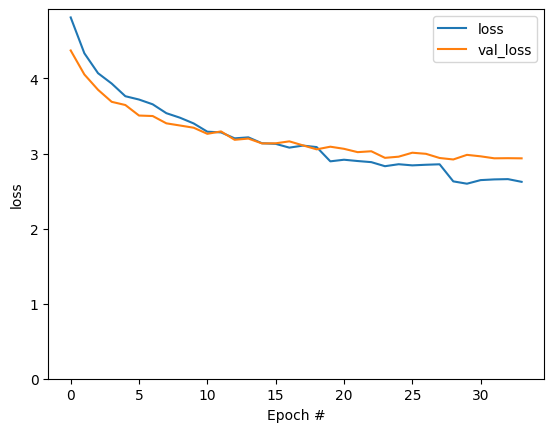

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.ylim([0, max(plt.ylim())])
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.legend()

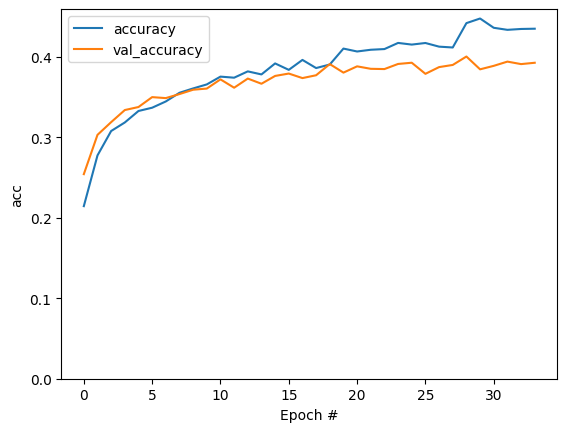

In [ ]:
plt.plot(history.history['masked_acc'], label='accuracy')
plt.plot(history.history['val_masked_acc'], label='val_accuracy')
plt.ylim([0, max(plt.ylim())])
plt.xlabel('Epoch #')
plt.ylabel('acc')
plt.legend()

(0.0, 5.121660435199738)

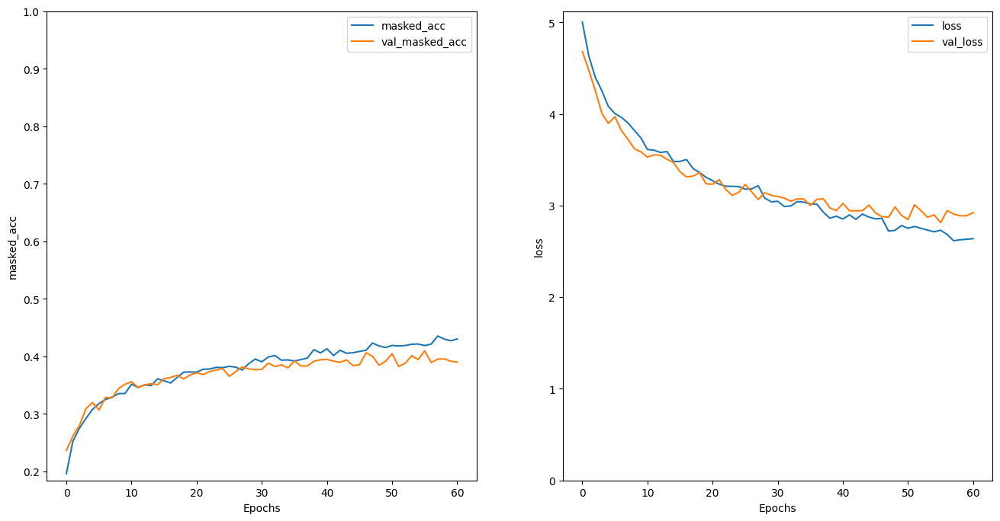

In [ ]:
import matplotlib.pyplot as plt

def plot_graphs(history, metric):
    plt.plot(history.history[metric])
    plt.plot(history.history['val_'+metric], '')
    plt.xlabel("Epochs")
    plt.ylabel(metric)
    plt.legend([metric, 'val_'+metric])

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plot_graphs(history, 'masked_acc')
plt.ylim(None, 1)
plt.subplot(1, 2, 2)
plot_graphs(history, 'loss')
plt.ylim(0, None)

## Save trained model

In [ ]:
from google.colab import drive
drive.mount("/content/MyDrive")

Mounted at /content/MyDrive


In [ ]:
# Lưu model
model.save_weights('/content/MyDrive/MyDrive/Colab Notebooks/saved_model.ckp') #, save_format='tf')

## Attention plots

Now, using the trained model,  run that `simple_gen` method on the image:

In [ ]:
result = model.simple_gen(image, temperature=0.0)
result

'a man in a yellow shirt is surfing'

Split the output back into tokens:

In [ ]:
str_tokens = result.split()
str_tokens.append('[END]')
str_tokens

['a', 'man', 'in', 'a', 'yellow', 'shirt', 'is', 'surfing', '[END]']

The `DecoderLayers` each cache the attention scores for their `CrossAttention` layer. The shape of each attention map is `(batch=1, heads, sequence, image)`:

In [ ]:
attn_maps = [layer.last_attention_scores for layer in model.decoder_layers]
[map.shape for map in attn_maps]

[TensorShape([1, 2, 9, 49]), TensorShape([1, 2, 9, 49])]

So stack the maps along the `batch` axis, then average over the `(batch, heads)` axes, while splitting the `image` axis back into `height, width`:


In [ ]:
attention_maps = tf.concat(attn_maps, axis=0)
attention_maps = einops.reduce(
    attention_maps,
    'batch heads sequence (height width) -> sequence height width',
    height=7, width=7,
    reduction='mean')

Now you have a single attention map, for each sequence prediction. The values in each map should sum to `1.`

In [ ]:
einops.reduce(attention_maps, 'sequence height width -> sequence', reduction='sum')

<tf.Tensor: shape=(9,), dtype=float32, numpy=
array([1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 0.99999994, 1.        , 1.        ], dtype=float32)>

So here is where the model was focusing attention while generating each token of the output:

In [ ]:
def plot_attention_maps(image, str_tokens, attention_map):
    fig = plt.figure(figsize=(16, 9))

    len_result = len(str_tokens)

    titles = []
    for i in range(len_result):
      map = attention_map[i]
      grid_size = max(int(np.ceil(len_result/2)), 2)
      ax = fig.add_subplot(3, grid_size, i+1)
      titles.append(ax.set_title(str_tokens[i]))
      img = ax.imshow(image)
      ax.imshow(map, cmap='gray', alpha=0.6, extent=img.get_extent(),
                clim=[0.0, np.max(map)])

    plt.tight_layout()

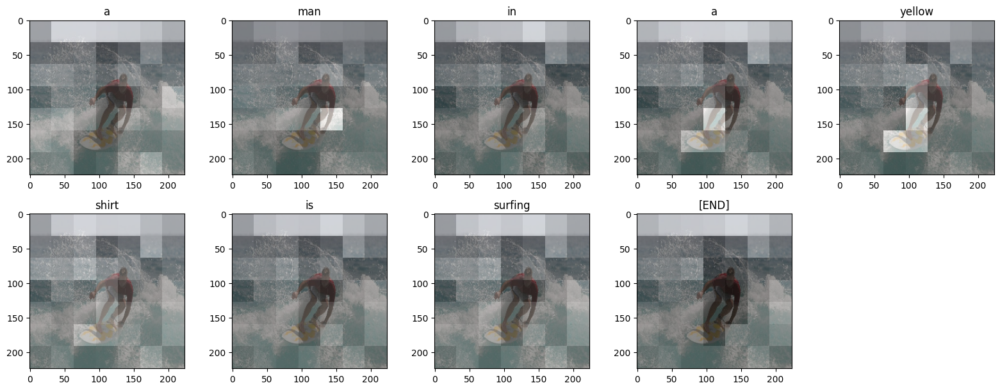

In [ ]:
plot_attention_maps(image/255, str_tokens, attention_maps)

Now put that together into a more usable function:

In [ ]:
@Captioner.add_method
def run_and_show_attention(self, image, temperature=0.0):
  result_txt = self.simple_gen(image, temperature)
  str_tokens = result_txt.split()
  str_tokens.append('[END]')

  attention_maps = [layer.last_attention_scores for layer in self.decoder_layers]
  attention_maps = tf.concat(attention_maps, axis=0)
  attention_maps = einops.reduce(
      attention_maps,
      'batch heads sequence (height width) -> sequence height width',
      height=7, width=7,
      reduction='mean')

  plot_attention_maps(image/255, str_tokens, attention_maps)
  t = plt.suptitle(result_txt)
  t.set_y(1.05)


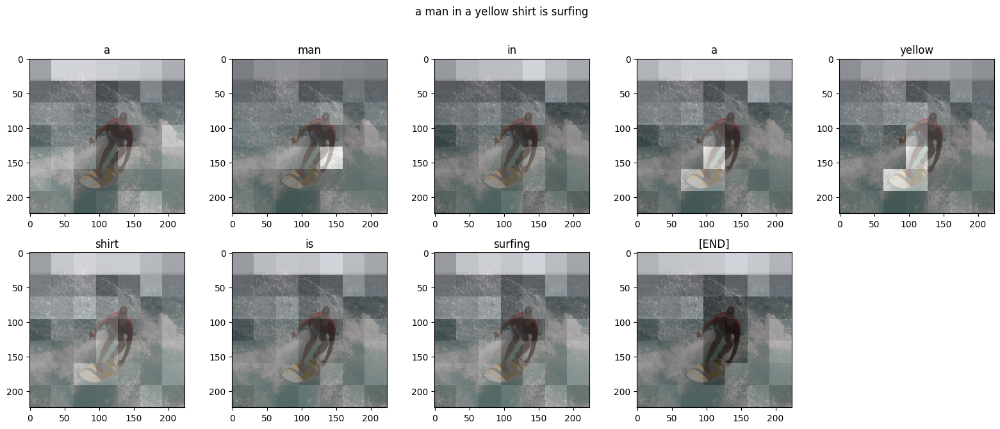

In [ ]:
run_and_show_attention(model, image)

## Try it on your own images

For fun, below you're provided a method you can use to caption your own images with the model you've just trained. Keep in mind, it was trained on a relatively small amount of data, and your images may be different from the training data (so be prepared for strange results!)


67460/67460 [==============================] - 0s 3us/step


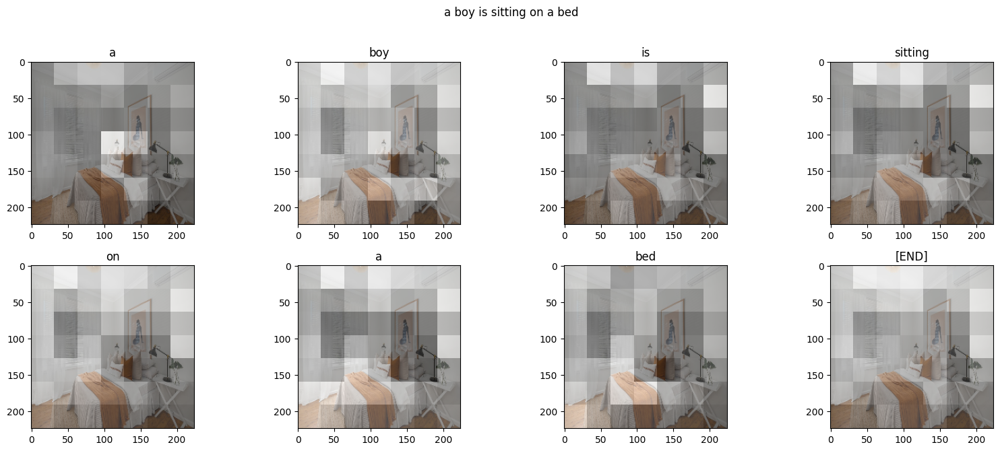

In [ ]:
image_url = 'https://tensorflow.org/images/bedroom_hrnet_tutorial.jpg'
image_path = tf.keras.utils.get_file(origin=image_url)
image = load_image(image_path)

run_and_show_attention(model, image)

## Load model and predict

In [ ]:
from google.colab import drive
drive.mount("/content/MyDrive")

Mounted at /content/MyDrive


In [ ]:
new_model = Captioner(tokenizer, feature_extractor=mobilenet, output_layer=output_layer,
                  units=256, dropout_rate=0.5, num_layers=2, num_heads=2)

new_model.load_weights('/content/MyDrive/MyDrive/Colab Notebooks/Image captioning/tensorflow/saved_model.ckp')

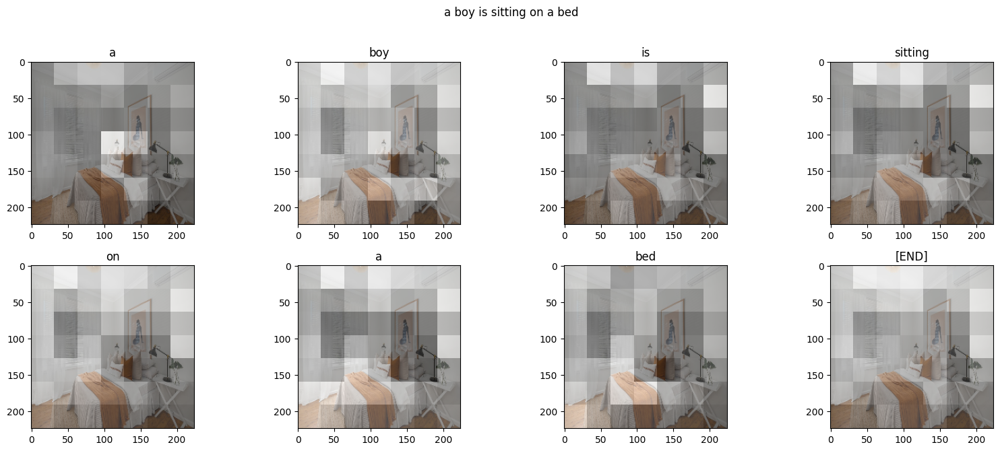

In [ ]:
def run_and_show_attention(image, temperature=0.0):
  result_txt = new_model.simple_gen(image, temperature)
  str_tokens = result_txt.split()
  str_tokens.append('[END]')

  attention_maps = [layer.last_attention_scores for layer in new_model.decoder_layers]
  attention_maps = tf.concat(attention_maps, axis=0)
  attention_maps = einops.reduce(
      attention_maps,
      'batch heads sequence (height width) -> sequence height width',
      height=7, width=7,
      reduction='mean')

  plot_attention_maps(image/255, str_tokens, attention_maps)
  t = plt.suptitle(result_txt)
  t.set_y(1.05)
run_and_show_attention(image)

## Check sample predictions

In [ ]:
import tensorflow as tf

# Function to filter the dataset based on image file path
def filter_dataset(image_path, dataset):
    filtered_dataset = dataset.filter(lambda x, y: tf.equal(x, image_path))
    return filtered_dataset

# Function to extract captions from the filtered dataset
def get_captions(image_path, dataset):
    filtered_dataset = filter_dataset(image_path.encode("utf-8"), dataset)
    captions = [caption.numpy().decode("utf-8") for _, captions in filtered_dataset for caption in captions]
    return captions

# Example usage
image_path = 'flickr8k/Flicker8k_Dataset/2513260012_03d33305cf.jpg'
captions = get_captions(image_path, train_raw)
print("Captions for image", image_path, ":\n", captions)

Captions for image flickr8k/Flicker8k_Dataset/2513260012_03d33305cf.jpg :
 ['A black dog is running after a white dog in the snow .', 'Black dog chasing brown dog through snow', 'Two dogs chase each other across the snowy ground .', 'Two dogs play together in the snow .', 'Two dogs running through a low lying body of water .']


In [ ]:
def split_caption(captions):
    result = []
    for caption in captions:
        text = caption.lower()
        text = text.split(' ')
        text = [i for i in text if word_to_index(i).numpy() != 1] # [UNK]
        result.append(text)
    return result
image_path = 'flickr8k/Flicker8k_Dataset/2513260012_03d33305cf.jpg'
captions = get_captions(image_path, train_raw)
print("Captions for image", image_path, ":\n", split_caption(captions))

Captions for image flickr8k/Flicker8k_Dataset/2513260012_03d33305cf.jpg :
 [['a', 'black', 'dog', 'is', 'running', 'after', 'a', 'white', 'dog', 'in', 'the', 'snow'], ['black', 'dog', 'chasing', 'brown', 'dog', 'through', 'snow'], ['two', 'dogs', 'chase', 'each', 'other', 'across', 'the', 'snowy', 'ground'], ['two', 'dogs', 'play', 'together', 'in', 'the', 'snow'], ['two', 'dogs', 'running', 'through', 'a', 'low', 'lying', 'body', 'of', 'water']]


In [ ]:
train_paths = [element[0].numpy().decode("utf-8") for element in list(train_raw)]
test_paths = [element[0].numpy().decode("utf-8") for element in list(test_raw)]

In [ ]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score

def generate_caption(image_path, data):
    smooth = SmoothingFunction()
    image = load_image(image_path)
    image = image.numpy().clip(0, 255).astype(np.uint8)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

    result_txt = new_model.simple_gen(image, temperature=0.0)
    print("Predicted Caption:", result_txt)
    print("Groundtruth Caption:")
    true_captions = get_captions(image_path, data)
    for cap in true_captions:
        print(cap)

    # Calculate the BLEU score
    score_bleu = sentence_bleu(split_caption(true_captions), result_txt.split(' '),
                          weights=([1],[1/2,1/2], [1/3,1/3,1/3], [1/4,1/4,1/4,1/4]),
                          smoothing_function=smooth.method1)
    print("BLEU score:")
    print(f"BLEU-1: {score_bleu[0]:.4f}")
    print(f"BLEU-2: {score_bleu[1]:.4f}")
    print(f"BLEU-3: {score_bleu[2]:.4f}")
    print(f"BLEU-4: {score_bleu[3]:.4f}")

    # Calculate the METEOR score
    score_meteor = meteor_score(split_caption(true_captions), result_txt.split(' '))
    print(f"METEOR score: {score_meteor:.4f}")

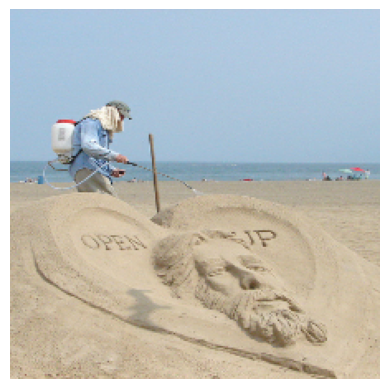

Predicted Caption: a boy is jumping on a beach
Groundtruth Caption:
A man in a blue shirt is spraying a sand sculpture .
A man is spraying a fluid from a long hose at the beach .
Man brushes image in the sand .
man sprays sand image of a man .
Man with white covering on is face spraying water on a mound of sand with a heart drawn that says open up .
BLEU score:
BLEU-1: 0.7143
BLEU-2: 0.3450
BLEU-3: 0.1335
BLEU-4: 0.0878
METEOR score: 0.1739


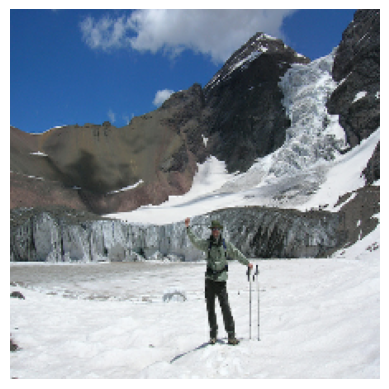

Predicted Caption: a man in a black jacket is standing on a snowy mountain
Groundtruth Caption:
A hiker waves to the camera as he standing in front of snowcapped mountains .
A man stands on the snow near the mountains .
A person poses in the snow .
A person stands in the snow at the top of a mountian , arms raised .
A skier in the mountains .
BLEU score:
BLEU-1: 0.4232
BLEU-2: 0.1805
BLEU-3: 0.0651
BLEU-4: 0.0401
METEOR score: 0.4000


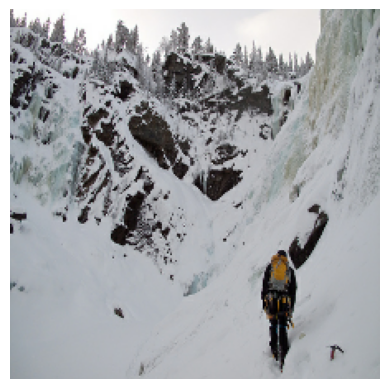

Predicted Caption: a person in a yellow jacket is skiing down a snowy hill
Groundtruth Caption:
A climber on a snowy mountain
A climber with a yellow backpack walks along the ridge of a snowy mountainside .
A man climbs a snowy mountain .
A mountain climber with a yellow backpack is walking on the side of a mountain .
A person cycling through snowy mountains .
BLEU score:
BLEU-1: 0.4938
BLEU-2: 0.3376
BLEU-3: 0.0988
BLEU-4: 0.0549
METEOR score: 0.3872


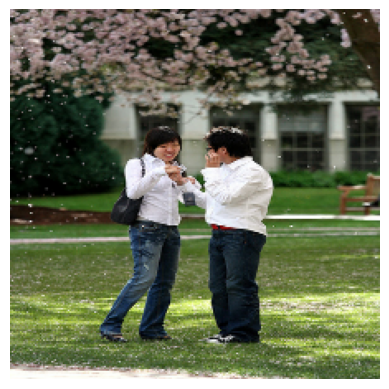

Predicted Caption: a man in a white shirt and white shirt and black shirt and white shirt is standing in front of a park
Groundtruth Caption:
A guy and a girl , both wearing white shirts and jeans , stand under a flowering tree .
A man and a woman are talking in a park
a man and woman standing underneath the tree are talking .
A man in a white shirt is standing in the grass showing something to a woman in a white shirt .
a young couple both wearing white shirts and blue jeans standing in a light misty rain
BLEU score:
BLEU-1: 0.6818
BLEU-2: 0.5698
BLEU-3: 0.4844
BLEU-4: 0.4158
METEOR score: 0.5111


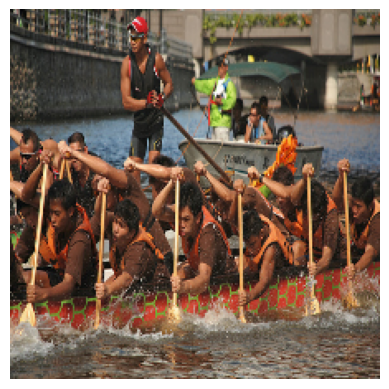

Predicted Caption: a group of people are in a raft in a lake
Groundtruth Caption:
A bunch of people rowing a canoe , with a boat full of people in the background .
A group of men in a canoe paddle down a river .
a team of rowers rowing in a green and red boat
Men wearing brown shirts with orange vests rowing orange and green boats .
Rowers racing furiously .
BLEU score:
BLEU-1: 0.6364
BLEU-2: 0.5045
BLEU-3: 0.3047
BLEU-4: 0.1371
METEOR score: 0.4646


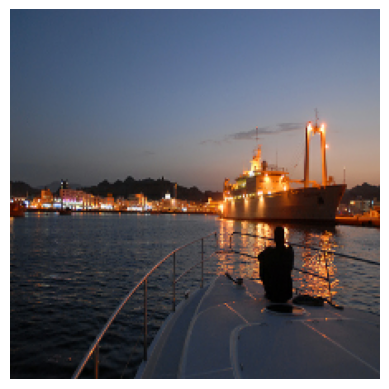

Predicted Caption: a man is standing on a boat on a lake
Groundtruth Caption:
A boat is illuminated at night .
A large ship on the water at dusk .
A man is sitting on the end of hit boat overlooking the water .
A person sits on the front deck of a ship and a city and another ships is lit up in the distance .
A ship in a harbor at night with a city skyline behind .
BLEU score:
BLEU-1: 0.7000
BLEU-2: 0.4830
BLEU-3: 0.3078
BLEU-4: 0.1429
METEOR score: 0.2929


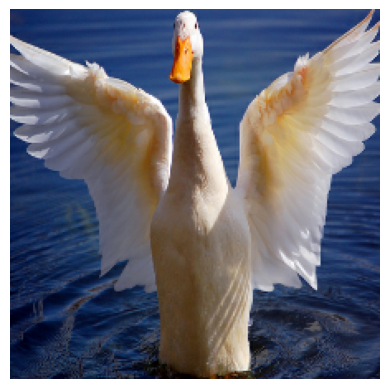

Predicted Caption: a white dog is jumping over a white water
Groundtruth Caption:
A white duck expanding its wings in the water .
A white duck is spreading its wings while sitting on the water .
A white duck spreads its wings while in the water .
white bird sitting in water spreading its wings
White duck flapping its wings in the water .
BLEU score:
BLEU-1: 0.4444
BLEU-2: 0.2357
BLEU-3: 0.0926
BLEU-4: 0.0603
METEOR score: 0.3155


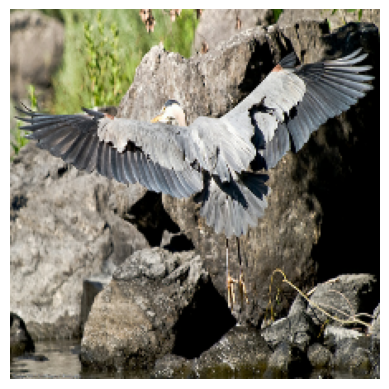

Predicted Caption: a man is climbing up a rock
Groundtruth Caption:
A bird has its wings spread very wide and is standing on rocks .
A bird takes off , surrounded by large rocks
A grey bird flies over the water by some rocks .
A large duck in flight over a rocky stream .
A seabird is flying over rocks .
BLEU score:
BLEU-1: 0.3715
BLEU-2: 0.0733
BLEU-3: 0.0453
BLEU-4: 0.0377
METEOR score: 0.2885


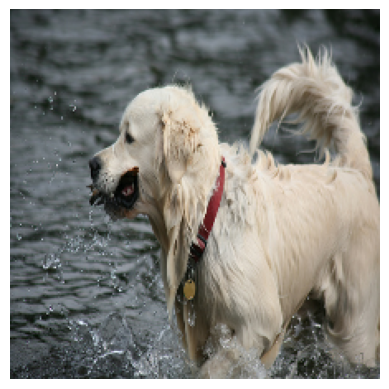

Predicted Caption: a white dog is running through the water
Groundtruth Caption:
A wet white dog is splashing in the water with a stick in its mouth .
A white dog is in the water .
A white dog treads the water with sticks in its mouth .
A white dog with red collar splashes in the water .
The dog is wading through shallow water while holding something in its mouth .
BLEU score:
BLEU-1: 0.8750
BLEU-2: 0.7071
BLEU-3: 0.5503
BLEU-4: 0.4273
METEOR score: 0.8294


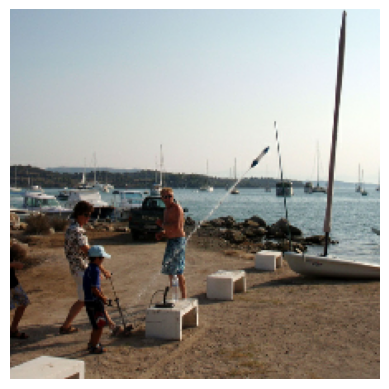

Predicted Caption: a man is sitting on a beach with a large body of water
Groundtruth Caption:
A boy and two men shooting off a water rocket at the beach .
A group of people are standing on the beach in front of some boats .
A group of people launch an air rocket in front of a marina .
A lady and a little boy use a pump to launch a rocket at a marina .
A little boy made blasted something off with water .
BLEU score:
BLEU-1: 0.6154
BLEU-2: 0.0716
BLEU-3: 0.0360
BLEU-4: 0.0261
METEOR score: 0.1765


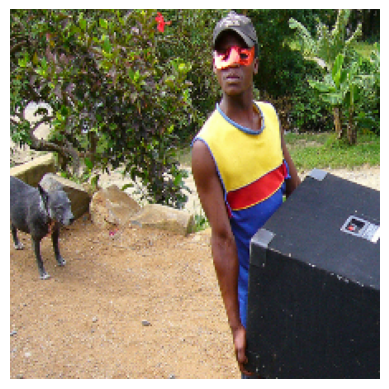

Predicted Caption: a man in a yellow shirt and a black hat and a black hat and a black dog
Groundtruth Caption:
A black man with a red mask is carrying a box .
A man in a domino mask carries an amplifier up a hill .
A man with a mask carrying a black speaker
A masked man in bright clothing carrying a large box .
Black man lifting black box is watched by black dog .
BLEU score:
BLEU-1: 0.5000
BLEU-2: 0.3835
BLEU-3: 0.2639
BLEU-4: 0.1871
METEOR score: 0.3758


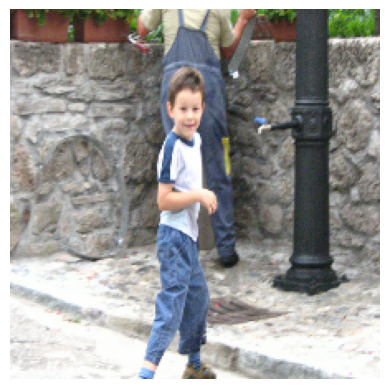

Predicted Caption: a young boy in a blue shirt and a woman in a blue shirt and a black shirt is standing on a man in a sidewalk
Groundtruth Caption:
A boy smiles in front of a stony wall in a city .
A little boy is standing on the street while a man in overalls is working on a stone wall .
A young boy runs aross the street .
A young child is walking on a stone paved street with a metal pole and a man behind him .
Smiling boy in white shirt and blue jeans in front of rock wall with man in overalls behind him .
BLEU score:
BLEU-1: 0.6154
BLEU-2: 0.5204
BLEU-3: 0.3235
BLEU-4: 0.1101
METEOR score: 0.3494


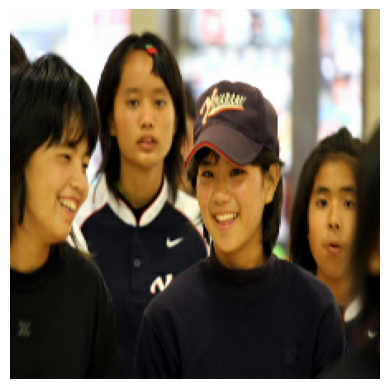

Predicted Caption: a group of young men are smiling and smiling
Groundtruth Caption:
A group of Asian girls are standing together .
A group of asian women in sports attire , and one woman in the center is wearing a baseball cap .
Four teenagers in dark clothes looking in various directions .
There are several asian people , one wearing a baseball cap .
Two girls laugh while other girls look on .
BLEU score:
BLEU-1: 0.5556
BLEU-2: 0.3727
BLEU-3: 0.2707
BLEU-4: 0.1349
METEOR score: 0.4630


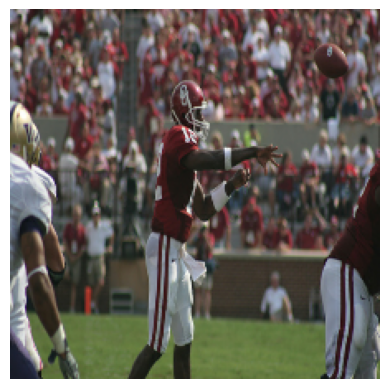

Predicted Caption: a football player in a white uniform is running in the field
Groundtruth Caption:
A football player is in action among other players .
a football player points .
An African-American football player , wearing jersey number 12 for the University of Oklahoma , throws a football to his left .
On a football field , there is a played in a red jersey and the crowd is behind him .
Several football players in a stadium
BLEU score:
BLEU-1: 0.6667
BLEU-2: 0.4264
BLEU-3: 0.2630
BLEU-4: 0.1192
METEOR score: 0.5324


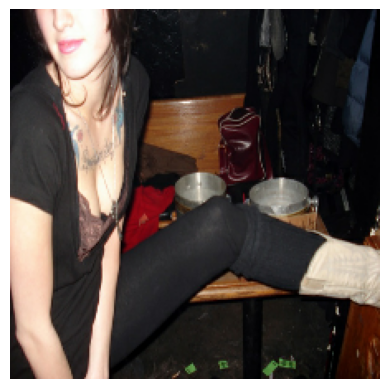

Predicted Caption: a man in a black shirt and a black shirt is sitting on a bench
Groundtruth Caption:
A girl dressed in black is posing for the camera .
A woman dressed in black .
A woman in black clothes with one leg up .
A woman in black leggings and beige cowboy boots .
A woman is propping her leg up revealing cleavage , a great tatoo , and some kicking boots .
BLEU score:
BLEU-1: 0.4000
BLEU-2: 0.0535
BLEU-3: 0.0280
BLEU-4: 0.0207
METEOR score: 0.3543


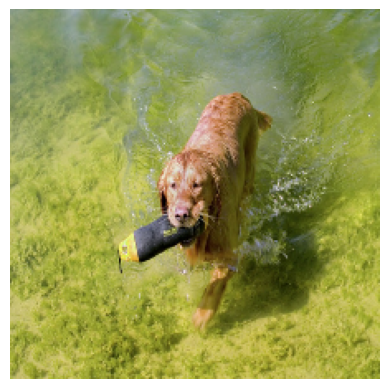

Predicted Caption: a dog is jumping into the water
Groundtruth Caption:
A brown dog carrying a black object .
A dog retrieving in the water .
A dog with a water pack is walking through clear green water .
The dog is running through the water carrying a black and yellow object in its mouth .
The Irish Setter is retrieving a flashlight from the pond .
BLEU score:
BLEU-1: 0.7143
BLEU-2: 0.5976
BLEU-3: 0.1926
BLEU-4: 0.1156
METEOR score: 0.6148


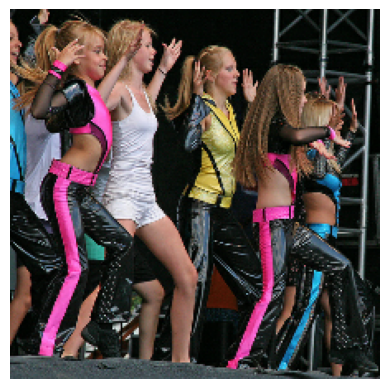

Predicted Caption: a group of girls are dancing in a parade
Groundtruth Caption:
A group of girls dancing on a stage .
A group of teenage girls do a synchronized dance in Hanna Montana costumes .
Girls in a line do a dance .
The girls are dancing and wearing leather outfits .
Young girls in dancing outfits perform on a stage .
BLEU score:
BLEU-1: 0.8889
BLEU-2: 0.8165
BLEU-3: 0.6586
BLEU-4: 0.4671
METEOR score: 0.6944


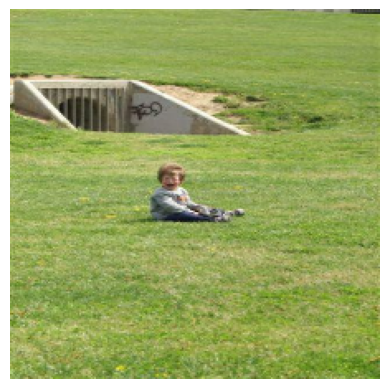

Predicted Caption: a boy is jumping over a fence
Groundtruth Caption:
A child is crying in a low cut field with a drainage pipe nearby .
A child is sitting on the grass by a concrete storm drain .
A young boy sitting is a field with a drain pipe in the background .
Baby by sewer drain cries
The young child is sitting on the grass in a park .
BLEU score:
BLEU-1: 0.5714
BLEU-2: 0.0976
BLEU-3: 0.0575
BLEU-4: 0.0467
METEOR score: 0.1504


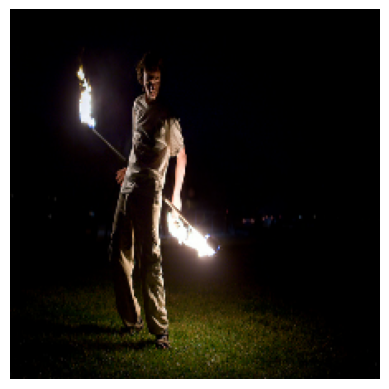

Predicted Caption: a man in a black shirt and white shirt is standing on a grassy field
Groundtruth Caption:
A male fire-dancer performs .
A man dances with a fire baton at night .
A man juggles a flaming staff in the dark .
A man twirling a flaming baton .
an african man is performing a trick with a stick that is burning with fire at both ends .
BLEU score:
BLEU-1: 0.2729
BLEU-2: 0.1263
BLEU-3: 0.0465
BLEU-4: 0.0288
METEOR score: 0.2604


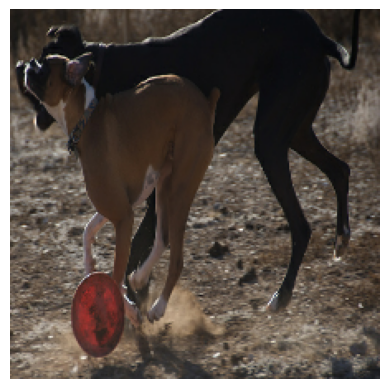

Predicted Caption: a brown dog is playing with a ball in the sand
Groundtruth Caption:
A brown dog and a black dog are playing with a red Frisbee .
A lack dog and a brown and white dog run on a gravel surface with something red underfoot .
A large black dog in the dirt with a small brown dog .
A large brown dog and a larger black dog playing together with a ball .
Two dogs are chasing a ball .
BLEU score:
BLEU-1: 0.7471
BLEU-2: 0.6398
BLEU-3: 0.4994
BLEU-4: 0.1942
METEOR score: 0.5334


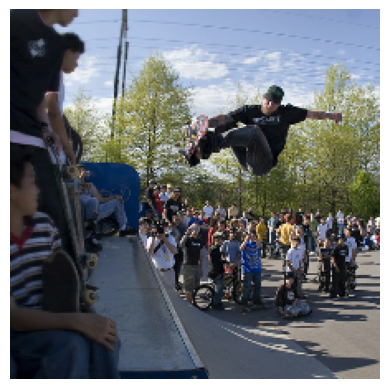

Predicted Caption: a man in a black shirt is riding a bicycle
Groundtruth Caption:
A man does skateboard tricks off a ramp while others watch .
A skateboarder does a trick for an audience .
A skateboarder doing a trick off a quarter pipe .
Boy dressed in black is doing a skateboarding jump with a crowd watching .
People watching a guy in a black and green baseball cap skateboarding .
BLEU score:
BLEU-1: 0.7000
BLEU-2: 0.4830
BLEU-3: 0.3078
BLEU-4: 0.1429
METEOR score: 0.1969


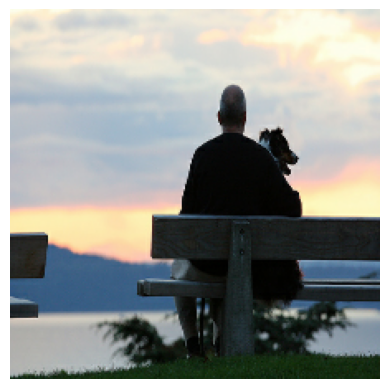

Predicted Caption: a man in a black shirt and a black jacket is standing on a bench
Groundtruth Caption:
A man and a dog sit on a bench near a body of water .
A man and his dog watch the sunset from a bench .
A man holding a dog sitting on a bench overlooking a lake .
a man holds his dog near a pond .
A man sits on a bench holding his dog and looking at the water .
BLEU score:
BLEU-1: 0.5333
BLEU-2: 0.3904
BLEU-3: 0.2272
BLEU-4: 0.0994
METEOR score: 0.3899


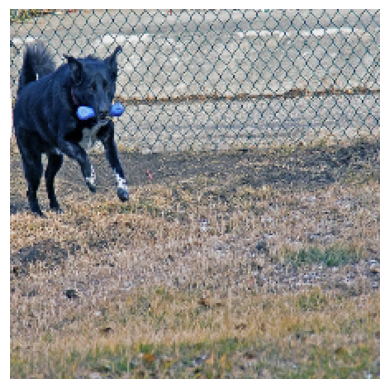

Predicted Caption: a black dog is running through a field
Groundtruth Caption:
A black and white dog with a blue toy in its mouth runs on a grassy surface just beyond a fence .
a black dog is running pasts a wire mesh fence with a blue bone shaped toy in its mouth .
A black dog is running with a blue bone in his mouth .
A black dog running with a blue toy in his mouth .
A dog is running with a blue bone in its mouth
BLEU score:
BLEU-1: 0.5155
BLEU-2: 0.4499
BLEU-3: 0.4113
BLEU-4: 0.3719
METEOR score: 0.5077


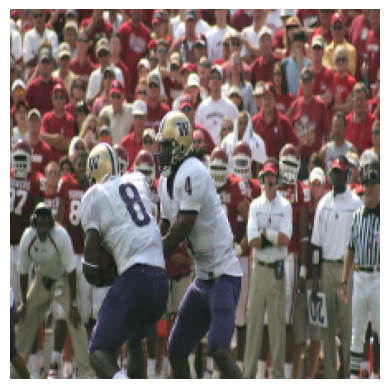

Predicted Caption: a football player in a white uniform is running in a field
Groundtruth Caption:
A football player passes the football to a teammate as the crowd looks on .
A quarterback hands off the football to a running back .
The football players wear purple pants , gold helmets and white jerseys .
Two football players fight to gain possession of the ball .
Two football players make a play , while the other team looks on .
BLEU score:
BLEU-1: 0.5000
BLEU-2: 0.3015
BLEU-3: 0.2087
BLEU-4: 0.1003
METEOR score: 0.2630


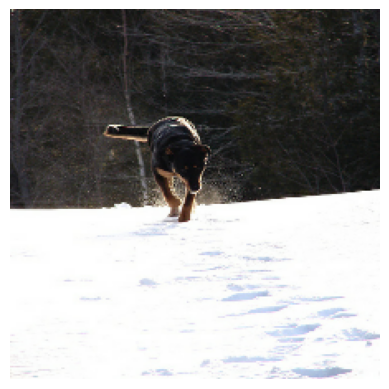

Predicted Caption: a dog is running through the snow
Groundtruth Caption:
A dog walks across the snow .
A dog walks through the snow in the daylight .
Black and brown dog approaching camera across snow .
Black dog runs through snow with head down
The large , dark colored dog is walking through the snow .
BLEU score:
BLEU-1: 0.8571
BLEU-2: 0.7559
BLEU-3: 0.4853
BLEU-4: 0.2312
METEOR score: 0.6148


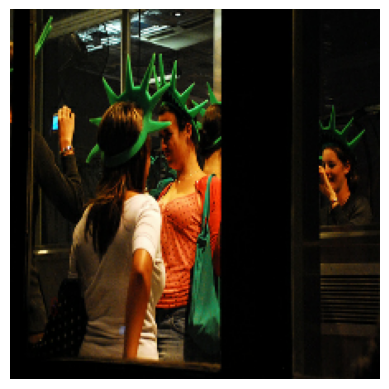

Predicted Caption: a man in a red shirt and a woman in a white shirt and a woman in a black shirt
Groundtruth Caption:
A few girls with green foam statue of liberty hats on a train
Some young adults are wearing green foam statute of liberty crowns .
Some young people take photos of each other while in New York .
Three woman with statue of liberty hats and taking a picture .
Two woman wearing statue of liberty hats get their picture taken in a subway .
BLEU score:
BLEU-1: 0.2500
BLEU-2: 0.1147
BLEU-3: 0.0418
BLEU-4: 0.0256
METEOR score: 0.1750


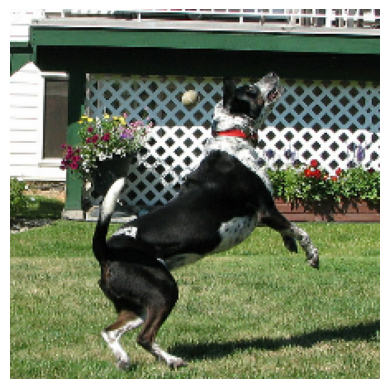

Predicted Caption: a black and white dog is jumping over a hurdle
Groundtruth Caption:
A black and white dog is playing with a ball on a lawn .
A black and white dog jumps up as a ball is thrown over his head .
dog jumping looking up and small white ball in air passed by
The black and white dog is attempting to catch a ball in the garden .
The dog jumps up waiting to catch something being thrown .
BLEU score:
BLEU-1: 0.9000
BLEU-2: 0.7071
BLEU-3: 0.6300
BLEU-4: 0.5721
METEOR score: 0.5675


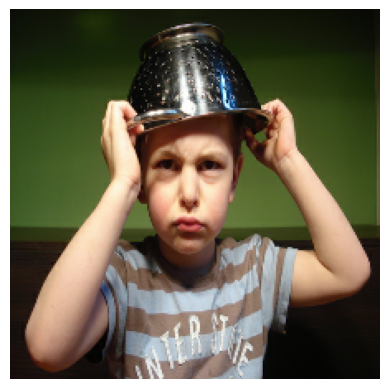

Predicted Caption: a boy in a blue shirt is wearing a blue shirt and white hat
Groundtruth Caption:
A boy with a metal colander on his head .
A little boy clowns with a colander on his head .
A mad boy who has a bowl on his head .
A young boy wears a metal colander on his head .
This boy in the striped shirt is putting a strainer on top of his head .
BLEU score:
BLEU-1: 0.3990
BLEU-2: 0.2928
BLEU-3: 0.0873
BLEU-4: 0.0487
METEOR score: 0.3035


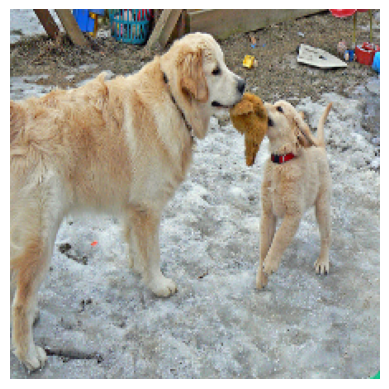

Predicted Caption: a dog is running through the water
Groundtruth Caption:
A big dog and a smaller dog fight over a piece of fabric .
A blonde dog is standing beside a blonde puppy , who is trying to get a stuffed animal from the adult dog .
An adult golden retriever and a puppy are playing tug of war with a brown toy .
An older dog and a younger one playing with a toy .
The small , golden dog is attempting to take a furry object from a larger look-alike
BLEU score:
BLEU-1: 0.3227
BLEU-2: 0.1743
BLEU-3: 0.0700
BLEU-4: 0.0469
METEOR score: 0.2373


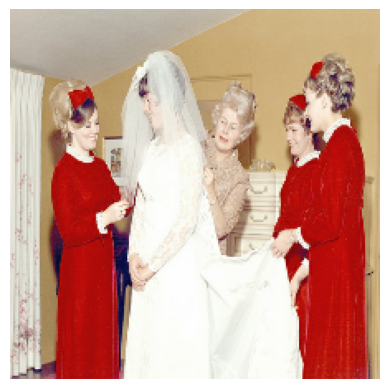

Predicted Caption: a bride and a white dress is standing in front of a white building
Groundtruth Caption:
A bride getting ready with her bridesmaids wearing red .
Bride wearing her wedding dress receives help by her bridesmaids wearing red dresses .
Family preparing for the wedding .
The woman getting married has a beautiful gown on while her bride 's maids are wearing red dresses .
Three bridesmaids in red and an older woman in beige are adjusting the bride 's white dress .
BLEU score:
BLEU-1: 0.4286
BLEU-2: 0.2568
BLEU-3: 0.0819
BLEU-4: 0.0473
METEOR score: 0.1582


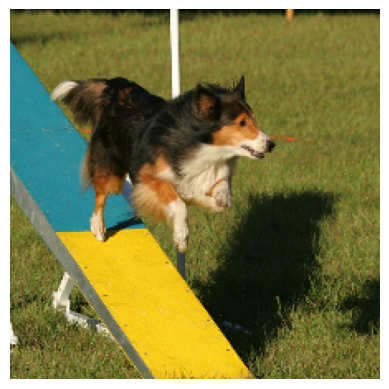

Predicted Caption: a dog jumps over a yellow and yellow and yellow dog
Groundtruth Caption:
A collie runs down a slide .
A dog is running down a ramp .
Dog is jumping down a ramp .
The collie is running down a blue and yellow board .
There is a brown and white dog jumping off of a see-saw .
BLEU score:
BLEU-1: 0.4545
BLEU-2: 0.3015
BLEU-3: 0.1003
BLEU-4: 0.0596
METEOR score: 0.2530


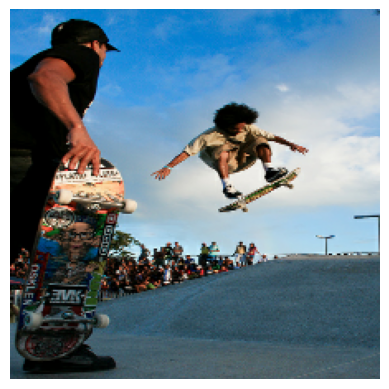

Predicted Caption: a man is doing a trick on a skateboard
Groundtruth Caption:
A man with an Afro propels his skateboard into the air .
A skateboarder does a trick in the air , another watches and so does a crowd .
A skateboarder is watching another skateboarder perform a jumping stunt .
Boy does skateboard trick .
The skateboarder is jumping his board in the air while another skateboarder watches .
BLEU score:
BLEU-1: 0.6960
BLEU-2: 0.3946
BLEU-3: 0.1258
BLEU-4: 0.0738
METEOR score: 0.2583


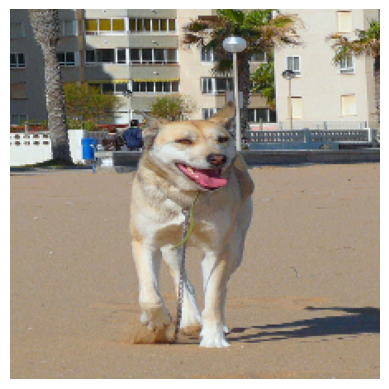

Predicted Caption: a dog runs on a beach
Groundtruth Caption:
A dog walking around with his leash but not with his owner .
a dog walks across the sand .
A sandy colored dog walking toward the camera with its leash attached and dragging below .
A tan and white dog walks in the sand on a nice day .
Dog with lease poses for the camera with its tongue hanging out .
BLEU score:
BLEU-1: 0.6667
BLEU-2: 0.5164
BLEU-3: 0.1882
BLEU-4: 0.1221
METEOR score: 0.2566


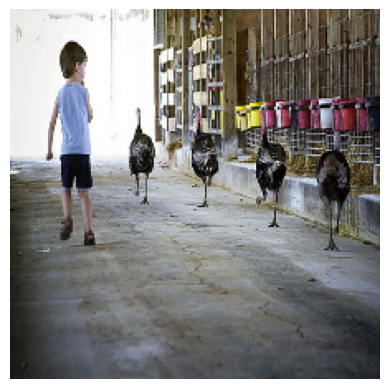

Predicted Caption: a man in a blue shirt and a white dog is running on a beach
Groundtruth Caption:
A child walking along side long legged birds .
A little boy and 4 turkeys walking
A small boy following 4 geese .
A small boy walks next to a group of four large birds .
A young boy walks down a road with four turkeys
BLEU score:
BLEU-1: 0.2000
BLEU-2: 0.0378
BLEU-3: 0.0222
BLEU-4: 0.0174
METEOR score: 0.1449


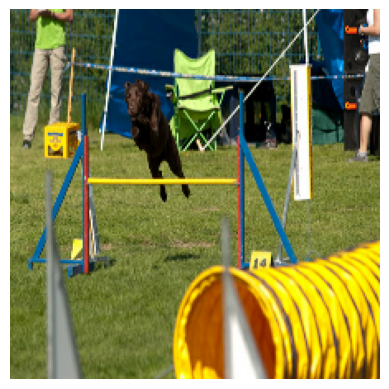

Predicted Caption: a dog jumps over a hurdle
Groundtruth Caption:
A black dog is jumping over a multicolored barrier .
A black dog jumping over an obstacle .
a black dog jumping over a yellow pole in an obstacle course
A dog is jumping over a hurdle .
Black dog jumping bar in obstacle course
BLEU score:
BLEU-1: 0.7054
BLEU-2: 0.5986
BLEU-3: 0.4232
BLEU-4: 0.2151
METEOR score: 0.8535


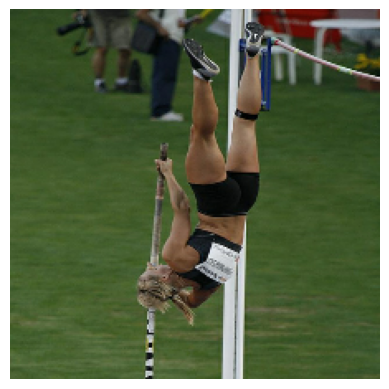

Predicted Caption: a man in a green shirt is jumping over a hurdle
Groundtruth Caption:
An athlete performs the high jump .
A woman athlete launching herself over the bar during a pole vault .
A woman is black is pole vaulting .
A woman pole vaulter upside down as she attempts the vault .
a woman with her feet in the air about to do pole vaulting
BLEU score:
BLEU-1: 0.4545
BLEU-2: 0.0674
BLEU-3: 0.0370
BLEU-4: 0.0282
METEOR score: 0.1364


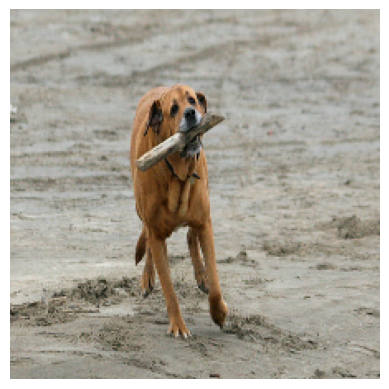

Predicted Caption: a brown dog is running on the beach
Groundtruth Caption:
A brown dog carrying a stick .
A brown dog runs on the sand carrying a stick .
A brown dog runs on the sand , holding a stick .
a dog is running across the sand with a stick in its mouth .
The dog is playing with the stick on the beach .
BLEU score:
BLEU-1: 1.0000
BLEU-2: 0.9258
BLEU-3: 0.7539
BLEU-4: 0.3043
METEOR score: 0.6009


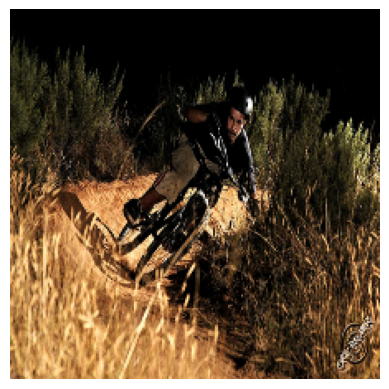

Predicted Caption: a man in a black jacket is riding a bike in a field
Groundtruth Caption:
A man in a black helmet riding his bike on a trail .
A man is riding a bicycle on a dirt path .
a man is riding a trails bicycle on a dirt track through rough terrain .
A man wearing a black bike helmet rides a bike on a brown , grassy surface with weeds all around .
Man riding a bicycle through dry grass
BLEU score:
BLEU-1: 0.7692
BLEU-2: 0.6699
BLEU-3: 0.5464
BLEU-4: 0.4250
METEOR score: 0.4962


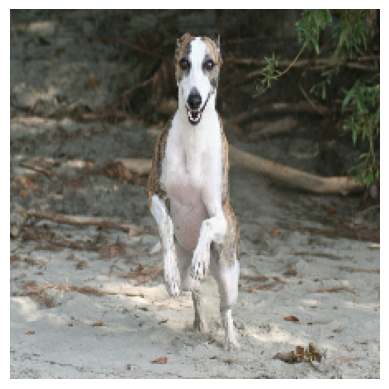

Predicted Caption: a white dog is running on a sandy beach
Groundtruth Caption:
a brown and white dog jumping on a sandy beach
A brown and white dog moving forward with two forelegs in the air and two hind legs on the ground .
A dog takes off running on the sand .
dog running on two legs
The white dog is running on the sand in front of fallen bushes .
BLEU score:
BLEU-1: 1.0000
BLEU-2: 0.9354
BLEU-3: 0.8550
BLEU-4: 0.7477
METEOR score: 0.6792


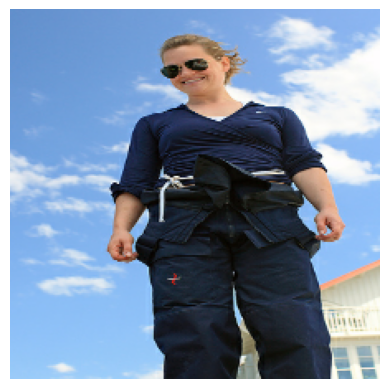

Predicted Caption: a boy in a blue shirt and blue shirt and a blue shirt is standing in front of a white building
Groundtruth Caption:
A smiling woman is wearing sunglasses on a day with sparse clouds .
A woman dressed in a Nike shirt and matching pants looks down at the ground .
A woman wearing a blue uniform stands and looks down .
The lady smiles on a clear day .
The woman is all dressed in blue and standing under a blue sky .
BLEU score:
BLEU-1: 0.4286
BLEU-2: 0.2535
BLEU-3: 0.0697
BLEU-4: 0.0370
METEOR score: 0.3153


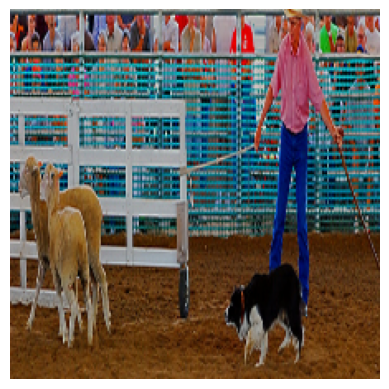

Predicted Caption: a dog and a dog are playing with a ball in a game
Groundtruth Caption:
A black and white dog is staring at two brown lambs .
A cowboy stands near two sheep and a dog at a rodeo .
a man in a pink shirt herding goats in a ring
A man uses two sticks to control two tan goats in a pen while a black and white dog watches .
The dog is herding sheep into a pen .
BLEU score:
BLEU-1: 0.4615
BLEU-2: 0.3397
BLEU-3: 0.2189
BLEU-4: 0.1012
METEOR score: 0.2818


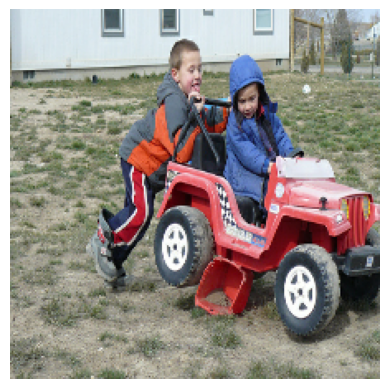

Predicted Caption: a man in a blue shirt and a red car
Groundtruth Caption:
A boy pushes another child in a kid-sized car .
A boy pushing a girl on a toy SUV .
one child in a red toy car while another pushes him
Two boys play on a toy car .
Two young boys , the older pushing the younger in a jeep shaped wagon .
BLEU score:
BLEU-1: 0.6000
BLEU-2: 0.3651
BLEU-3: 0.1186
BLEU-4: 0.0699
METEOR score: 0.2896


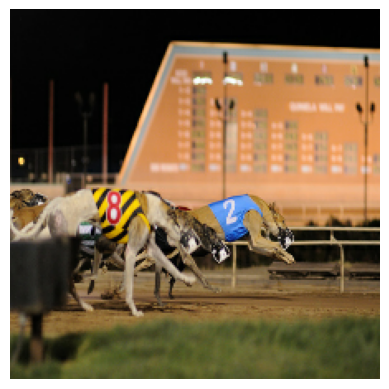

Predicted Caption: a greyhound dog is jumping over a hurdle
Groundtruth Caption:
A few horses race each other on the track .
Muzzled greyhounds are racing along a dog track at night .
Race dog # 2 is ahead of a few other dogs .
Several greyhounds with numbered shirts racing around a track .
The dogs in numbered uniforms are running .
BLEU score:
BLEU-1: 0.3750
BLEU-2: 0.0732
BLEU-3: 0.0447
BLEU-4: 0.0366
METEOR score: 0.1685


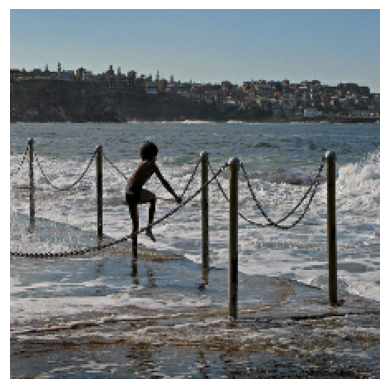

Predicted Caption: a boy and a dog are walking through the water
Groundtruth Caption:
A boy playing on a chain at a beach
A child begins to climb over a chain with water on the other side .
A child crossing a chain fence to get to the water .
A child is climbing over a chain leading to open water .
A young boy on the beach by ropes .
BLEU score:
BLEU-1: 0.5000
BLEU-2: 0.3333
BLEU-3: 0.1116
BLEU-4: 0.0667
METEOR score: 0.2896


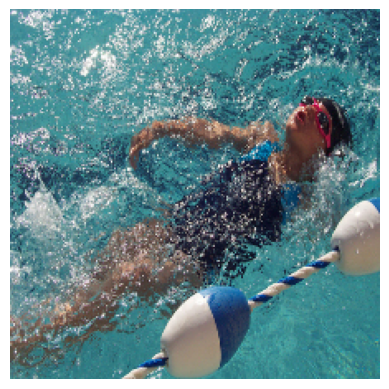

Predicted Caption: a boy in a blue shirt is swimming in a pool
Groundtruth Caption:
A girl does the backstroke in the pool .
A swimmer does the backstroke in a swimming pool .
A swimmer in a dark blue suit swimming backstroke .
A young girl in swim goggles does the backstroke in a pool .
The girl wearing pink goggles is in the swimming pool doing the backstroke .
BLEU score:
BLEU-1: 0.6641
BLEU-2: 0.3482
BLEU-3: 0.2309
BLEU-4: 0.1089
METEOR score: 0.4295


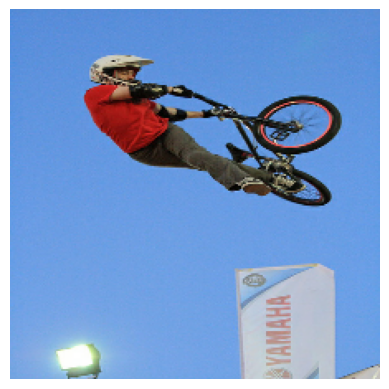

Predicted Caption: a man in a red shirt is jumping his bike
Groundtruth Caption:
A bicyclist performing a trick in midair .
A biker is doing an aerial trick on his bike .
A guy does a trick in the air .
A man wearing a helmet is doing a stunt with his BMX bike .
The man wearing a red shirt is performing an aerial stunt on a bicycle .
BLEU score:
BLEU-1: 0.9000
BLEU-2: 0.7071
BLEU-3: 0.5000
BLEU-4: 0.3656
METEOR score: 0.3758


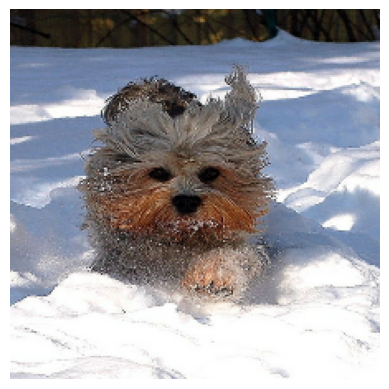

Predicted Caption: a small dog running through the snow
Groundtruth Caption:
a fluffy little dog running through the snow
An ash colored dog is walking forward in the snow .
a small dog walking through the snow
A small tan dog runs through the snow .
A tan dog is walking through snow .
BLEU score:
BLEU-1: 1.0000
BLEU-2: 1.0000
BLEU-3: 0.9283
BLEU-4: 0.7953
METEOR score: 0.8757


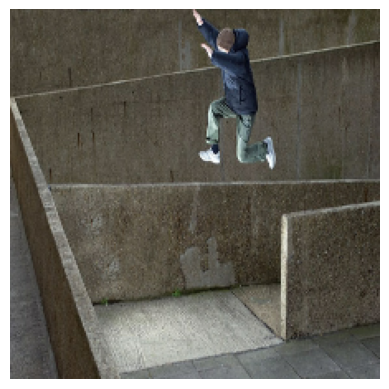

Predicted Caption: a man in a blue shirt is jumping over a wooden fence
Groundtruth Caption:
A boy wearing a blue parka , green pants , and white shoes is leaping in a ramp .
a man performs a large jump .
A man wearing a blue jacket jumping from one concrete wall to the other .
A person in a blue jacket jumps off of a tan cement wall .
Someone in a blue coat and white sneakers is airborne .
BLEU score:
BLEU-1: 0.6134
BLEU-2: 0.3923
BLEU-3: 0.2419
BLEU-4: 0.1097
METEOR score: 0.3962


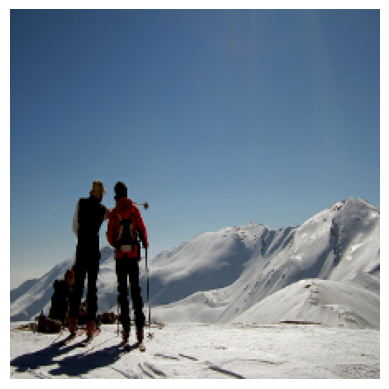

Predicted Caption: a man in a red jacket and white jacket and a backpack is standing on a snowy mountain
Groundtruth Caption:
Skiiers on a snowy mountain .
Skiiers on top of a mountain .
Two men stand on skis and look to a snowy mountain to the right .
Two people wearing skis stand looking at a mountain .
Two skiers stand near a snowy mountain .
BLEU score:
BLEU-1: 0.2778
BLEU-2: 0.2214
BLEU-3: 0.1830
BLEU-4: 0.1422
METEOR score: 0.6300


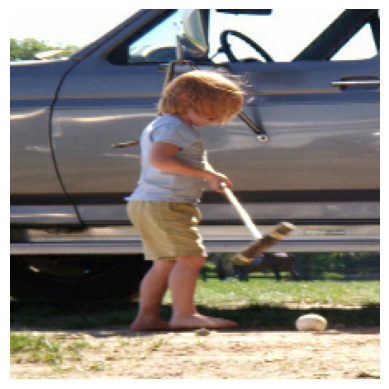

Predicted Caption: a little girl is playing in a park
Groundtruth Caption:
A little baby plays croquet .
A little girl plays croquet next to a truck .
The child is playing croquette by the truck .
The kid is in front of a car with a put and a ball .
The little boy is playing with a croquet hammer and ball beside the car .
BLEU score:
BLEU-1: 0.8750
BLEU-2: 0.6124
BLEU-3: 0.3969
BLEU-4: 0.1880
METEOR score: 0.5011


In [ ]:
for i in range(50):
    generate_caption(np.random.choice(train_paths), train_raw)

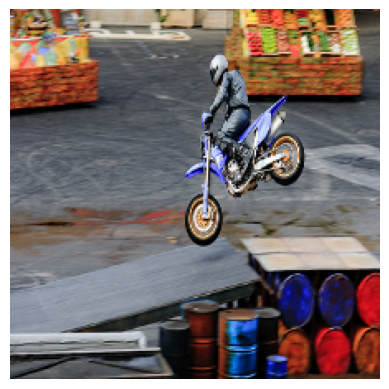

Predicted Caption: a man on a bike is doing a trick on a bike
Groundtruth Caption:
A blue motorcycle is jumping over some colored barrels .
A dirt biker lands on a ramp .
A man riding a blue motorcycle jumps over a ramp .
a motorcyclist jumping on a ramp
A motorcyclist rides down a ramp held up by colorful barrels .
BLEU score:
BLEU-1: 0.5000
BLEU-2: 0.3015
BLEU-3: 0.0969
BLEU-4: 0.0564
METEOR score: 0.3872


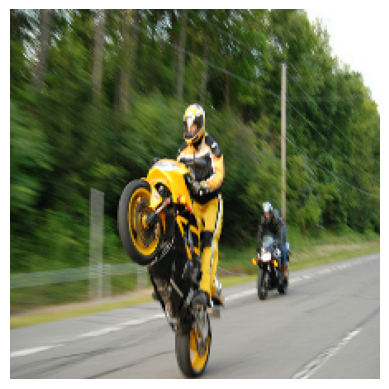

Predicted Caption: a man in a yellow helmet rides a bike
Groundtruth Caption:
A man on a motorcycle riding on his back tire .
A man on a yellow sport bike does a wheelie as his friend on a black bike catches up .
A yellow motorcyclist is popping a wheelie .
The orange rider is driving a motorcycle on one wheel .
Two motorcyclists on a blurry road , one rider doing a wheelie .
BLEU score:
BLEU-1: 0.5966
BLEU-2: 0.3653
BLEU-3: 0.1195
BLEU-4: 0.0710
METEOR score: 0.3549


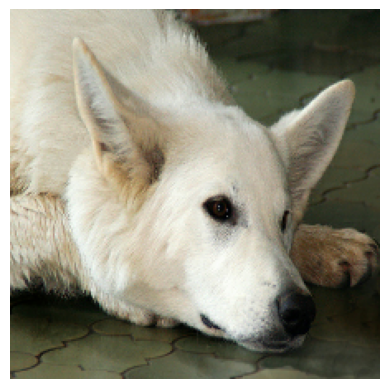

Predicted Caption: a white dog with a white dog in its mouth
Groundtruth Caption:
A closeup of a white dog that is laying its head on its paws .
a large white dog lying on the floor .
A white dog has its head on the ground .
A white dog is resting its head on a tiled floor with its eyes open .
A white dog rests its head on the patio bricks .
BLEU score:
BLEU-1: 0.6000
BLEU-2: 0.3651
BLEU-3: 0.2554
BLEU-4: 0.1242
METEOR score: 0.4121


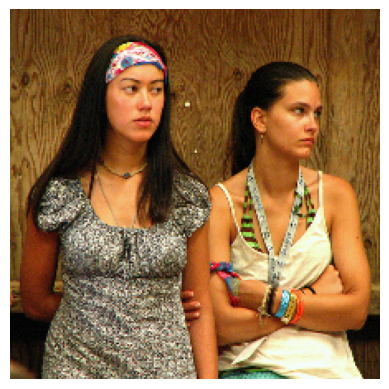

Predicted Caption: a girl in a pink shirt and a woman in a white shirt and a woman in a black shirt
Groundtruth Caption:
Two females are standing next to each other and appear to be unexcited .
Two girls are standing by a wooden wall looking off to their left .
Two women with black hair stand in front of plywood .
Two young women are leaning up against a wooden wall .
Two young women , one with folded arms , look off screen .
BLEU score:
BLEU-1: 0.2000
BLEU-2: 0.0324
BLEU-3: 0.0180
BLEU-4: 0.0136
METEOR score: 0.0990


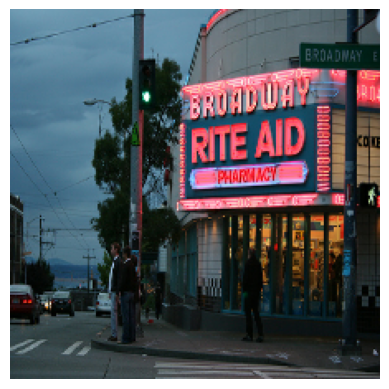

Predicted Caption: a man in a black shirt is walking down a street
Groundtruth Caption:
People stand on a street corner at dusk , with a pharmacy in the background .
People stand outside of the Rite Aid pharmacy on Broadway .
People waiting to cross the street in front of a pharmacy with lit up sign .
Some people look to cross the street in front of a drug store .
This is a picture of a Broadway Rite Aid Pharmacy that has a bright neon sign and people are prepared to cross the street in front of it .
BLEU score:
BLEU-1: 0.4981
BLEU-2: 0.2133
BLEU-3: 0.0773
BLEU-4: 0.0479
METEOR score: 0.1563


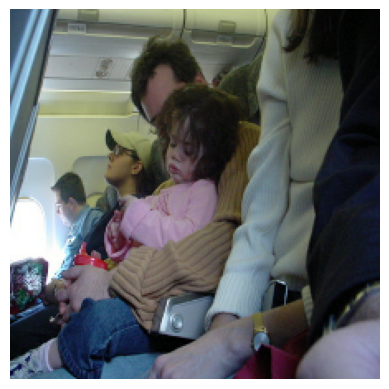

Predicted Caption: a man in a white shirt and a woman sitting on a couch
Groundtruth Caption:
A man sits in an airplane seat holding a young girl in his arms , surrounded by other passengers .
A small girl wearing pink sleeps on a man 's lap as they ride in an airplane .
A young girl falls asleep in her father 's arms while seated on an airplane .
Little girl sleeping in crowded airplane
Young girl wearing a pink sweater sitting on a man .
BLEU score:
BLEU-1: 0.4274
BLEU-2: 0.3145
BLEU-3: 0.2027
BLEU-4: 0.0937
METEOR score: 0.4330


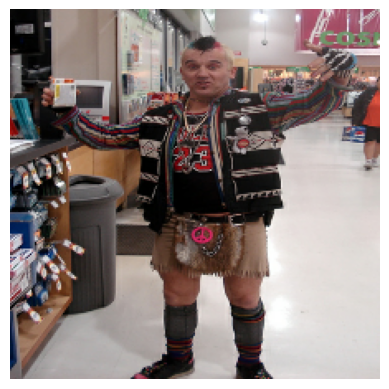

Predicted Caption: a man in a black shirt and white shirt and black shorts is standing in front of a building
Groundtruth Caption:
A man with a Mohawk with his arms in the air .
A man with multicolored hair wearing a weird outfit
A person in a kilt and a sports jersey and a Mohawk is in a store .
Punk rocker buys computer ink in the big-box store .
The man with the eccentric clothing and hair poses in a store .
BLEU score:
BLEU-1: 0.4737
BLEU-2: 0.2294
BLEU-3: 0.0676
BLEU-4: 0.0373
METEOR score: 0.2454


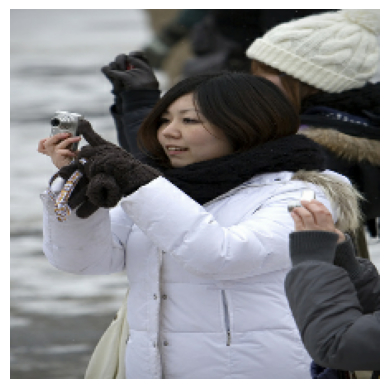

Predicted Caption: a man in a white shirt and a white shirt is holding a white shirt
Groundtruth Caption:
A girl in a white coat takes pictures .
A girl in a white puffy jacket takes a picture .
a group of people looking into their cameras
Asian woman in white coat takes photo .
The woman in the white coat is holding a camera in her hand .
BLEU score:
BLEU-1: 0.4667
BLEU-2: 0.3651
BLEU-3: 0.2737
BLEU-4: 0.1143
METEOR score: 0.4276


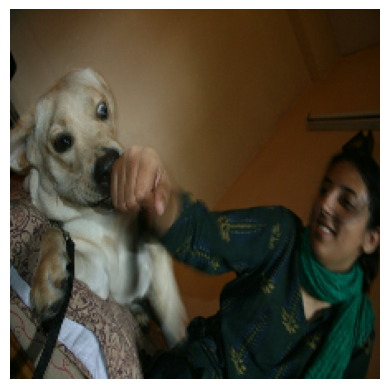

Predicted Caption: a dog is laying on a bed
Groundtruth Caption:
A smiling woman punching a dog .
A tan dog licks a girls hand while laying down .
A woman dressed in green is playing with her tan dog .
The girl with the green scarf and the white dog appear to be playing .
The light brown dog with white spots is nibbling on the girls hand .
BLEU score:
BLEU-1: 0.8571
BLEU-2: 0.3780
BLEU-3: 0.1419
BLEU-4: 0.0919
METEOR score: 0.2459


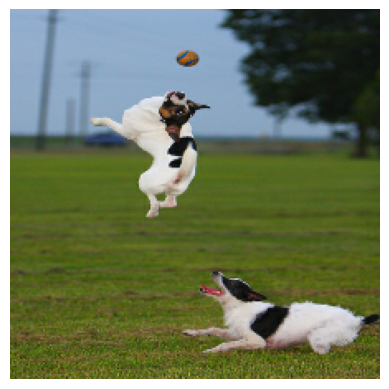

Predicted Caption: a white dog is jumping over a white and white dog
Groundtruth Caption:
One dog leaps to catch a softball while another looks on .
The two dogs , one of which is leaping in the air , are chasing a ball outdoors .
two dogs jump for a ball on a green field .
Two dogs play catch with a ball in a field .
Two small dogs pursuing a ball across a grassy field .
BLEU score:
BLEU-1: 0.3636
BLEU-2: 0.0603
BLEU-3: 0.0343
BLEU-4: 0.0267
METEOR score: 0.2400


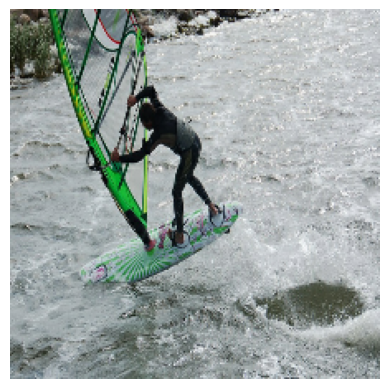

Predicted Caption: a man in a green shirt is riding a green rope
Groundtruth Caption:
A kite surfer begins to fall in the ocean .
A man parasails in the choppy water .
A man wakeboards on choppy water .
A man windsurfs in a wetsuit .
A windsurfer is balancing on choppy water .
BLEU score:
BLEU-1: 0.4545
BLEU-2: 0.3693
BLEU-3: 0.3118
BLEU-4: 0.2481
METEOR score: 0.5636


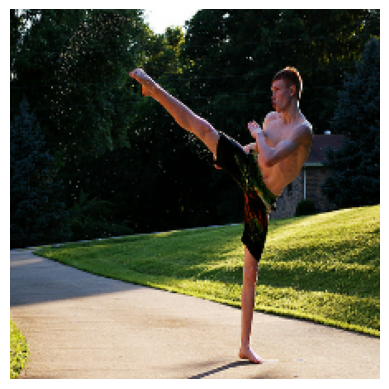

Predicted Caption: a boy jumps off a ramp
Groundtruth Caption:
A man in black shorts is stretching out his leg .
A man practicing a high kick on the cement near the grass .
A young , fit man wearing short does a high right kick in the air .
A young man practices a martial art kicking skill in front of his home in the early morning .
A young man wearing shorts and no shirt is high kicking as water flies from his clothing .
BLEU score:
BLEU-1: 0.1711
BLEU-2: 0.0419
BLEU-3: 0.0283
BLEU-4: 0.0249
METEOR score: 0.0877


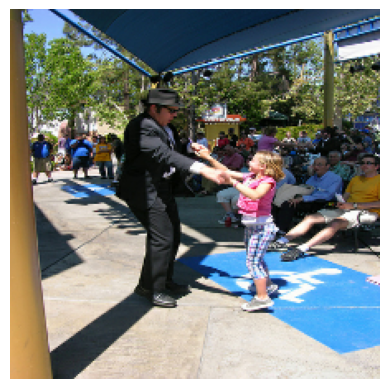

Predicted Caption: a man in a black shirt and black pants and a girl are playing in a park
Groundtruth Caption:
A man and a girl stand in front of a large crowd .
A man dances with a girl .
A man in a suit dances with a young girl in front of an audience .
A man wearing black dances with a young girl wearing a pink shirt .
The man wearing the blues brothers suit is dancing with the little girl in the pink top .
BLEU score:
BLEU-1: 0.5882
BLEU-2: 0.4287
BLEU-3: 0.3325
BLEU-4: 0.2264
METEOR score: 0.4580


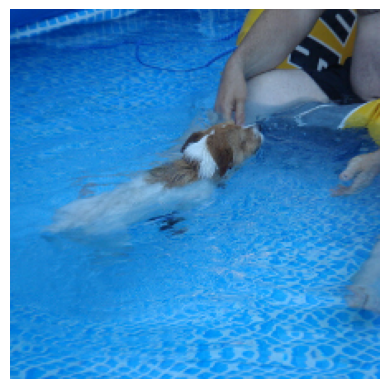

Predicted Caption: a dog is jumping into the pool
Groundtruth Caption:
a brown and white dog swimming towards some in the pool
A dog in a swimming pool swims toward sombody we cannot see .
A dog swims in a pool near a person .
Small dog is paddling through the water in a pool .
The small brown and white dog is in the pool .
BLEU score:
BLEU-1: 0.5368
BLEU-2: 0.4491
BLEU-3: 0.1447
BLEU-4: 0.0869
METEOR score: 0.3866


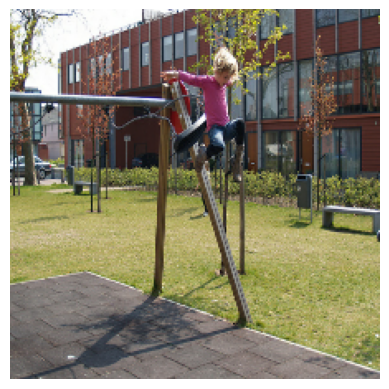

Predicted Caption: a man in a red shirt and black pants is jumping over a fence
Groundtruth Caption:
A girl dismounts from a swing as high as she can and lands on the rubber tiles below .
A girl in a pink shirt jumping out of a moving swing .
A little girl wearing a pink shirt jumps off a swing .
A young girl jumps off a playground swing .
The young girl in the pink shirt and blue jeans is jumping off the tire swing .
BLEU score:
BLEU-1: 0.5714
BLEU-2: 0.3631
BLEU-3: 0.1032
BLEU-4: 0.0562
METEOR score: 0.3495


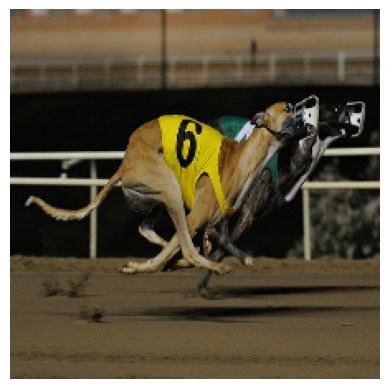

Predicted Caption: a greyhound is running on a track
Groundtruth Caption:
A brown number six race dog is slightly behind a black race dog on a track .
two dogs race across the track .
Two greyhounds race .
two muzzled greyhound dogs running around a track
Two muzzled racing dogs running along track .
BLEU score:
BLEU-1: 1.0000
BLEU-2: 0.5774
BLEU-3: 0.4055
BLEU-4: 0.2021
METEOR score: 0.3995


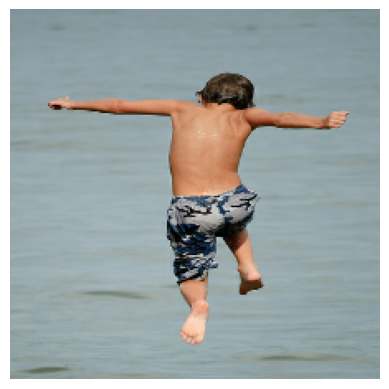

Predicted Caption: a boy in a blue shirt is jumping in the air
Groundtruth Caption:
A boy in a swimsuit jumping into water .
A boy in blue camo pants jumping into water .
A boy is about to jump into the water .
A boy jumps into the water at a beach .
A young man leaps into the water .
BLEU score:
BLEU-1: 0.7273
BLEU-2: 0.4671
BLEU-3: 0.3646
BLEU-4: 0.2790
METEOR score: 0.4482


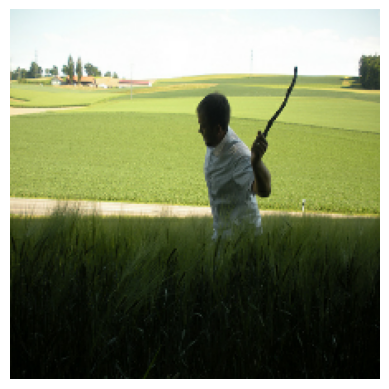

Predicted Caption: a young girl is jumping in a field of grass
Groundtruth Caption:
A man in a white shirt swinging a stick
A man in a white shirt walks in the tall grass holding a stick .
A man is walking in a field carrying a stick .
A man with a stick in his left hand in a field
Man near golf course preparing to throw a stick
BLEU score:
BLEU-1: 0.6000
BLEU-2: 0.3651
BLEU-3: 0.2554
BLEU-4: 0.1242
METEOR score: 0.3178


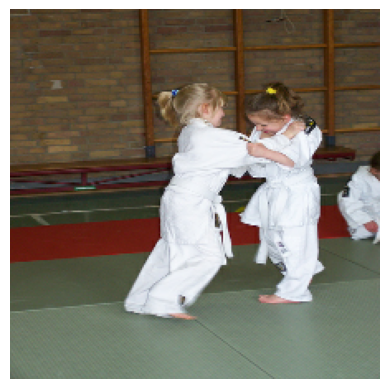

Predicted Caption: two girls are playing basketball
Groundtruth Caption:
Two girls in karate uniforms struggle in a dojo .
Two little girls are dressed in white karate uniforms .
Two little girls practice martial arts .
Two little girls spar in a Karate bout .
Two young girls sparring in white martial arts outfits while a third person watches from the side .
BLEU score:
BLEU-1: 0.4912
BLEU-2: 0.4484
BLEU-3: 0.1764
BLEU-4: 0.1224
METEOR score: 0.2972


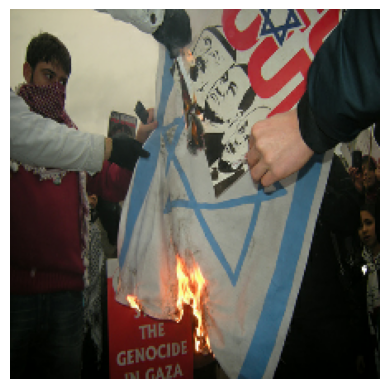

Predicted Caption: a man in a white shirt and a white shirt is holding a sign
Groundtruth Caption:
A masked man helps burn a flag .
I man with a covered face burning an israei flag in front of a crowd .
Men burn an Israeli flag .
Some middle eastern people have set an Israeli flag on fire .
The man is wearing a red shirt and red flannel handkerchief while watching a flag burn .
BLEU score:
BLEU-1: 0.5000
BLEU-2: 0.1961
BLEU-3: 0.0684
BLEU-4: 0.0413
METEOR score: 0.2500


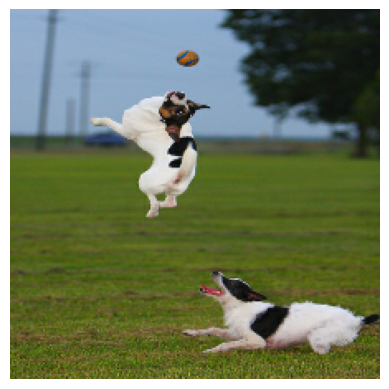

Predicted Caption: a white dog is jumping over a white and white dog
Groundtruth Caption:
One dog leaps to catch a softball while another looks on .
The two dogs , one of which is leaping in the air , are chasing a ball outdoors .
two dogs jump for a ball on a green field .
Two dogs play catch with a ball in a field .
Two small dogs pursuing a ball across a grassy field .
BLEU score:
BLEU-1: 0.3636
BLEU-2: 0.0603
BLEU-3: 0.0343
BLEU-4: 0.0267
METEOR score: 0.2400


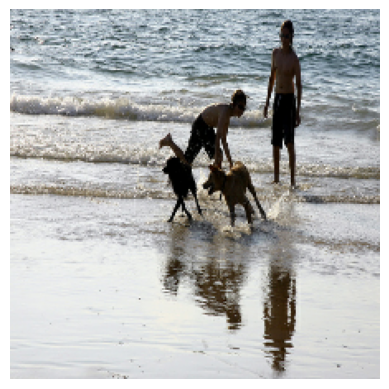

Predicted Caption: two dogs are running on the beach
Groundtruth Caption:
Two boys and two dogs are playing in the sand and water at the seashore .
Two boys are playing with two dogs on the beach .
Two boys play with two dogs at the shore .
Two boys play with two dogs next to the ocean .
Two guys are playing with two dogs on the beach .
BLEU score:
BLEU-1: 0.6441
BLEU-2: 0.5681
BLEU-3: 0.4595
BLEU-4: 0.2066
METEOR score: 0.6932


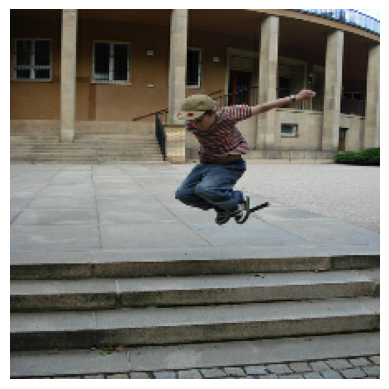

Predicted Caption: a man in a shirt is doing a skateboard
Groundtruth Caption:
A boy in a baseball cap jumps over a flight of stairs .
A boy in a striped shirt and hat does tricks on the steps .
A boy , wearing a baseball cap , jumps in the air near some steps .
a young man jumping through the air near a staircase
There is a boy wearing jeans and a baseball cap jumping in the air .
BLEU score:
BLEU-1: 0.6960
BLEU-2: 0.2790
BLEU-3: 0.0998
BLEU-4: 0.0621
METEOR score: 0.2698


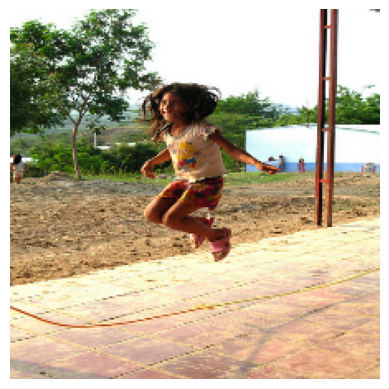

Predicted Caption: a girl in a pink shirt and shorts is playing on a beach
Groundtruth Caption:
A girl jumping over a jump rope .
A girl wearing pink shoes jumps over a rope and smiles .
A girl wearing shorts plays jump rope .
A little girl is jumping over a yellow rope .
A small girl with brown hair and a big smile is jumping rope .
BLEU score:
BLEU-1: 0.5385
BLEU-2: 0.2118
BLEU-3: 0.0742
BLEU-4: 0.0449
METEOR score: 0.2632


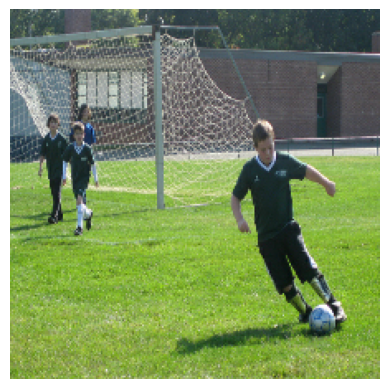

Predicted Caption: a boy in black and white shirt and black pants is playing soccer
Groundtruth Caption:
A boy in a green uniform is kicking a soccer ball in a game while two others stand behind him .
Boys play soccer near a goal post .
Some children are playing soccer on a sports-field by the goal .
The little boy gets ready to kick the soccer ball .
three boys play soccer .
BLEU score:
BLEU-1: 0.4615
BLEU-2: 0.3397
BLEU-3: 0.2189
BLEU-4: 0.1012
METEOR score: 0.5215


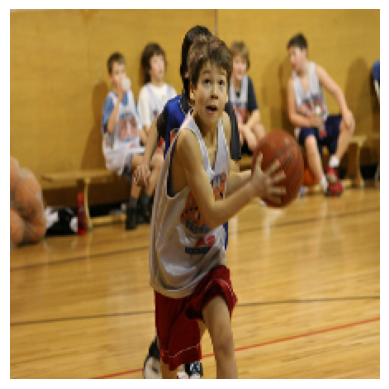

Predicted Caption: a basketball player in a blue uniform is running
Groundtruth Caption:
A boy with red shorts is holding a basketball in a basketball court .
A young boy is playing basketball in an official game .
The boy is playing basketball .
The boy runs with the basketball while looking up .
The children are playing basketball indoors .
BLEU score:
BLEU-1: 0.5556
BLEU-2: 0.3727
BLEU-3: 0.1257
BLEU-4: 0.0758
METEOR score: 0.4733


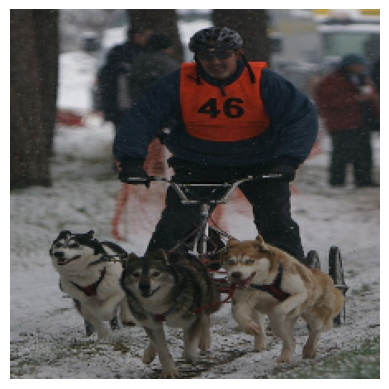

Predicted Caption: two dogs are running through the snow
Groundtruth Caption:
a froup of sled dogs pulling a man wearing an orange vest .
A three dog sled team pulls an unusual tricycle sled .
Several dogs carry a man with a helmet through snow .
The dogs are pulling a man on a type of bike , through the snow .
Three dogs pulling a man on a bicycle through the snow .
BLEU score:
BLEU-1: 0.4653
BLEU-2: 0.3893
BLEU-3: 0.2703
BLEU-4: 0.1339
METEOR score: 0.3639


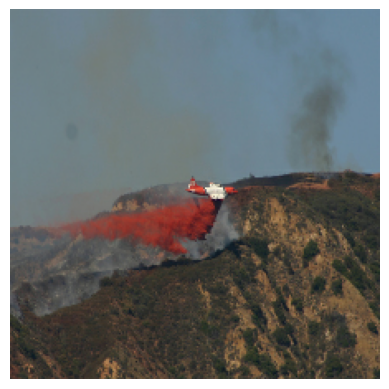

Predicted Caption: a man in a red shirt is standing on a rock
Groundtruth Caption:
Airplane emitting heavy red colored smoke .
An airplane is flying over the mountain trying to extinguish a fire .
A small plane is dropping a red chemical over the mountaintops .
Red spray is being ejected by an orange and white plane flying over the hilltops .
Small red airplane flies over mountaintop dropping red substance over fire .
BLEU score:
BLEU-1: 0.3636
BLEU-2: 0.1907
BLEU-3: 0.0739
BLEU-4: 0.0474
METEOR score: 0.2174


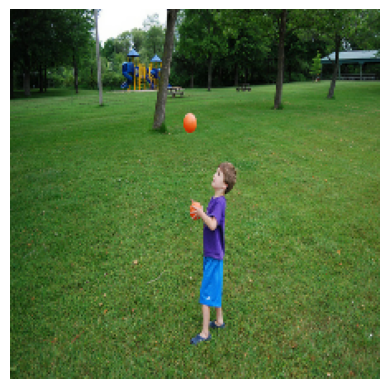

Predicted Caption: a little boy in a blue shirt and blue jeans is playing soccer
Groundtruth Caption:
A boy in a park playing with two orange balls .
A boy in a purple shirt tosses orange balls on a lawn .
A little boy in a purple shirt and blue shorts playing with orange balls .
Boy playing on the grass with an orange ball .
Little boy juggling orange balls in the park with a playground behind him .
BLEU score:
BLEU-1: 0.6923
BLEU-2: 0.5883
BLEU-3: 0.5012
BLEU-4: 0.3983
METEOR score: 0.6355


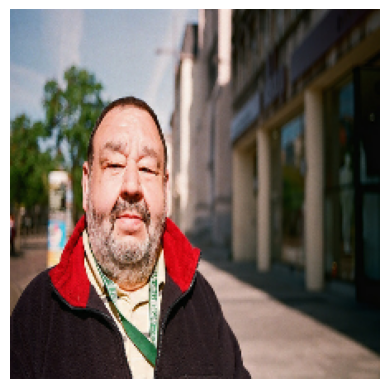

Predicted Caption: a man in a black shirt and a black shirt and a woman in a red shirt
Groundtruth Caption:
A closeup of an elderly man .
A man poses outdoors .
A man with a red collar and gray beard looks at the camera .
An older man wearing a black jacket standing outside .
Bearded man in fleece jacket smiles for a picture , the background is blurry
BLEU score:
BLEU-1: 0.4118
BLEU-2: 0.3208
BLEU-3: 0.0882
BLEU-4: 0.0471
METEOR score: 0.2776


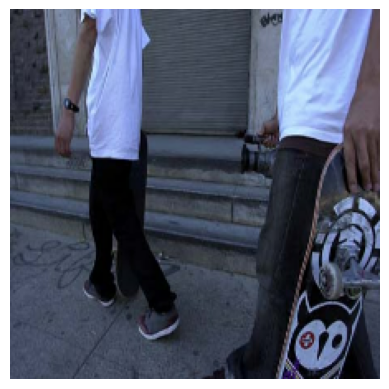

Predicted Caption: a man in a white shirt and a white shirt and a woman in a white shirt and a white shirt and a white shirt and a black hat
Groundtruth Caption:
The camera focuses on two people 's legs .
The legs and mid-sections of two people with skateboards .
Two guys walking , one carrying a skateboard
two male skaters walk on sidewalk
two people wearing white shirts and jeans each carrying a skateboard
BLEU score:
BLEU-1: 0.1034
BLEU-2: 0.0192
BLEU-3: 0.0111
BLEU-4: 0.0085
METEOR score: 0.2930


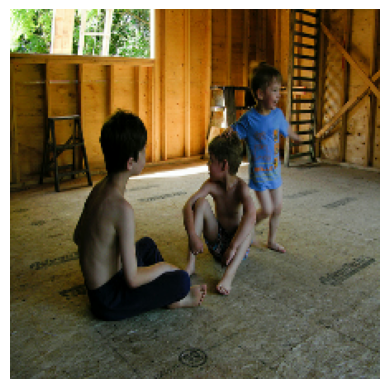

Predicted Caption: two children are playing on a sidewalk
Groundtruth Caption:
Three boys in a building under construction .
Three boys play in an unfinished building .
Three boys playing in an unfinished space .
Three little boys are playing on the floor of an unfinished house .
Two young boys sit and one young boy stands on an unfinished wooden floor .
BLEU score:
BLEU-1: 0.7143
BLEU-2: 0.4880
BLEU-3: 0.3625
BLEU-4: 0.1858
METEOR score: 0.2560


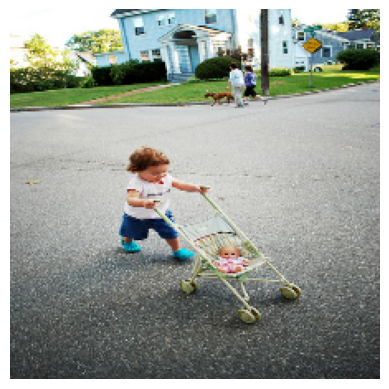

Predicted Caption: a girl is playing on a sidewalk
Groundtruth Caption:
A child pushes a doll in a baby carriage .
A little girl pushing a baby doll stroller
A little kid in blue shoes is pushing a toy baby in a stroller .
A small child pushes a stroller down the street .
a young child carrying a doll in a stroller
BLEU score:
BLEU-1: 0.4954
BLEU-2: 0.0846
BLEU-3: 0.0499
BLEU-4: 0.0405
METEOR score: 0.1899


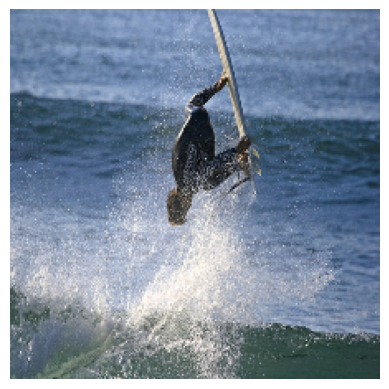

Predicted Caption: a boy is jumping into the water
Groundtruth Caption:
A surfer does a flip on a wave .
A surfer is 90 degrees to the water
A surfer is flipping up in the air on a surfboard .
a surfer jumps out of the water .
The surfer does a flip off of a wave .
BLEU score:
BLEU-1: 0.5714
BLEU-2: 0.3086
BLEU-3: 0.1240
BLEU-4: 0.0831
METEOR score: 0.5174


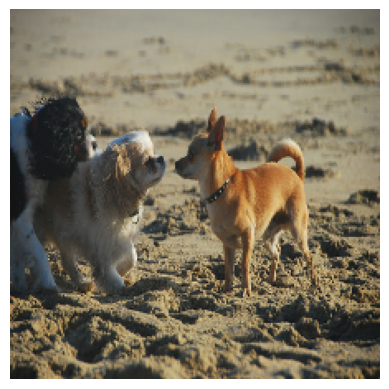

Predicted Caption: a dog running on the beach
Groundtruth Caption:
The three dogs are standing in the sand .
Three small dogs stand in the sand and stare at each other .
Three small dogs , two of which are sniffing noses .
Two dogs meet and check out a third dog at the beach .
Two small dogs facing a third dog .
BLEU score:
BLEU-1: 0.5643
BLEU-2: 0.3091
BLEU-3: 0.1264
BLEU-4: 0.0869
METEOR score: 0.2769


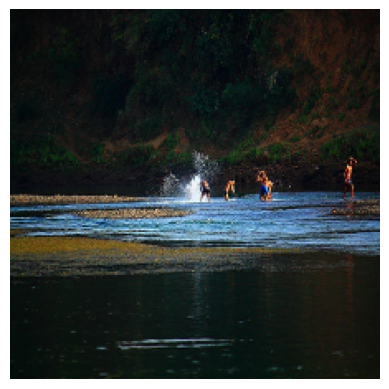

Predicted Caption: a dog is running through the water
Groundtruth Caption:
A group of friends play in a lake .
Five people are in a natural water source .
many children play in the water .
People in bathing suits bend down and reach into the water of a lake .
Several people are playing outside in the water .
BLEU score:
BLEU-1: 0.4286
BLEU-2: 0.2673
BLEU-3: 0.1126
BLEU-4: 0.0773
METEOR score: 0.4189


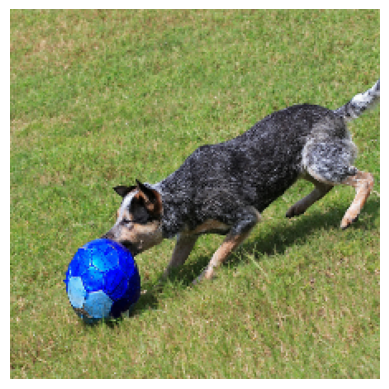

Predicted Caption: a black and white dog is running through a field
Groundtruth Caption:
A black and grey dog is playing with a blue ball outside .
A dog is playing with a ball on the grass .
a dog playing with a blue ball
A gray dog chases a blue soccer ball on the grass .
A graying dog is pushing a blue soccer ball downhill with his nose .
BLEU score:
BLEU-1: 0.6000
BLEU-2: 0.4472
BLEU-3: 0.2924
BLEU-4: 0.1375
METEOR score: 0.5699


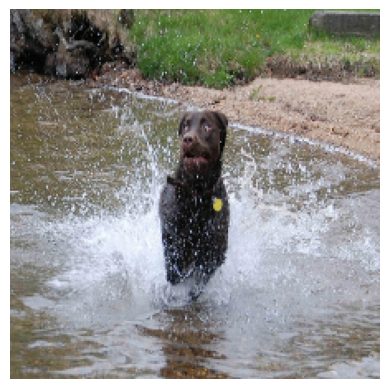

Predicted Caption: a dog is running through the water
Groundtruth Caption:
A brown dog splashing through water .
A dog is running through a pond
a dog pounces into the water .
The large brown dog is running through shallow water .
There is a chocolate brown dog running in water .
BLEU score:
BLEU-1: 1.0000
BLEU-2: 0.9129
BLEU-3: 0.7937
BLEU-4: 0.7071
METEOR score: 0.6914


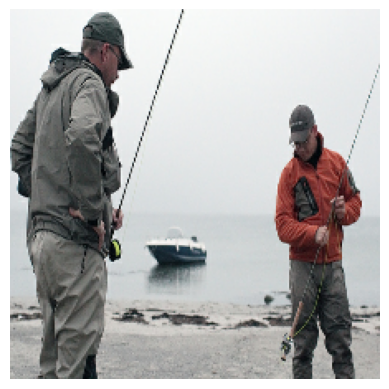

Predicted Caption: a man in a red jacket and a man in a red jacket and a man in a red shirt and a black jacket
Groundtruth Caption:
Men standing on shore with fishing pole and boat in water
Two fisherman looking at the water .
Two men holding their fishing poles .
Two men stand near the water with their fishing poles .
Two men with fishing rods are standing on a shore
BLEU score:
BLEU-1: 0.1250
BLEU-2: 0.0233
BLEU-3: 0.0135
BLEU-4: 0.0104
METEOR score: 0.0813


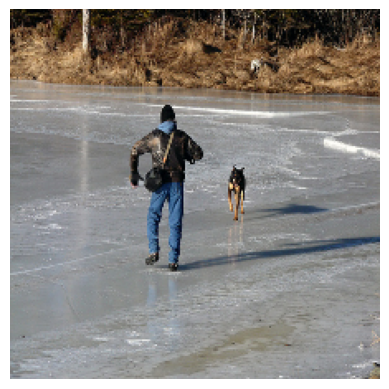

Predicted Caption: a boy in a blue shirt and black dog are running through the water
Groundtruth Caption:
A man and a dog running across shallow water on a beach .
A man and his dog walk on the ice of a frozen pond .
A man dressed in winter clothes is on the beach wiht a dog .
a man in a brown jacket is running on a sandy bay towards a dog that is in turn running towards him .
The backview of a man dressed up in a jacket and a dog running towards him .
BLEU score:
BLEU-1: 0.5714
BLEU-2: 0.2097
BLEU-3: 0.0716
BLEU-4: 0.0427
METEOR score: 0.2459


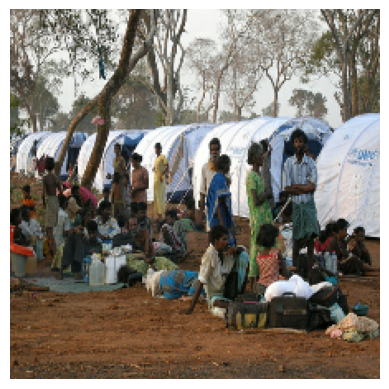

Predicted Caption: a group of people are sitting on a bench in front of a group of people
Groundtruth Caption:
A crowd of dark skinned people standing outside of white tents .
A group of people stand and sit on the dirt near a line of several white tents .
A group of refugees and sitting next to their tents .
People are gathered by a tree beside a line of white tents .
Some people sit , and some stand in a group of families before a background of white tents with UN markings .
BLEU score:
BLEU-1: 0.5871
BLEU-2: 0.3835
BLEU-3: 0.2703
BLEU-4: 0.1943
METEOR score: 0.3866


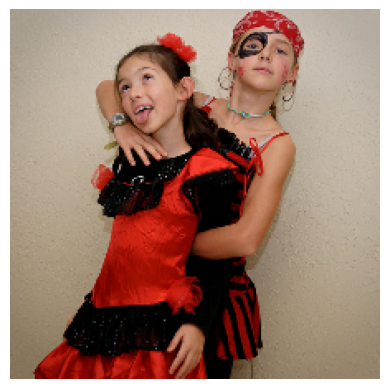

Predicted Caption: a young girl wearing a red shirt and red hat is wearing a red and red shirt
Groundtruth Caption:
A girl dressed in a red dress and another girl dressed as a pirate are playing around .
Girls dressed in red and black costumes hold a wrestling pose .
two girls dress up for halloween .
Two girls in red costumes play together .
Two little girls in red and black costumes are posing for a picture .
BLEU score:
BLEU-1: 0.3529
BLEU-2: 0.2100
BLEU-3: 0.0665
BLEU-4: 0.0381
METEOR score: 0.1765


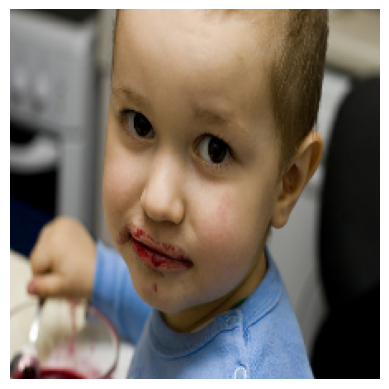

Predicted Caption: a baby with a blue shirt is holding a baby in his mouth
Groundtruth Caption:
A baby eats and has food on his face .
A boy with lips messy from eating fruit
A little boy is eating something and got it all over his mouth .
A small child with berries all over its mouth .
A young brown eyed boy with red syrup on his lips is pouring syrup .
BLEU score:
BLEU-1: 0.4615
BLEU-2: 0.2774
BLEU-3: 0.0888
BLEU-4: 0.0514
METEOR score: 0.2719


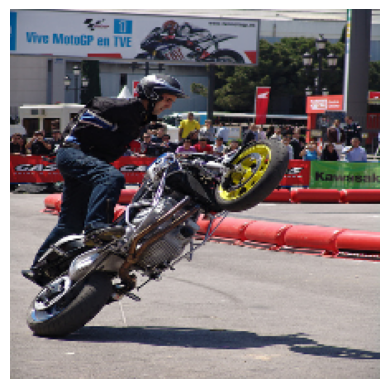

Predicted Caption: a man in a black shirt is riding a bike
Groundtruth Caption:
a man doing tricks on a motorcycle
A man puts his motorcycle up on its rear wheel on a track .
A man riding a motorcycle is performing a trick at a track .
A man stands on his motorcycle while doing a wheelie .
The motorcycle is being ridden on a track whilst pulling a wheelie .
BLEU score:
BLEU-1: 0.6000
BLEU-2: 0.3651
BLEU-3: 0.1186
BLEU-4: 0.0699
METEOR score: 0.2542


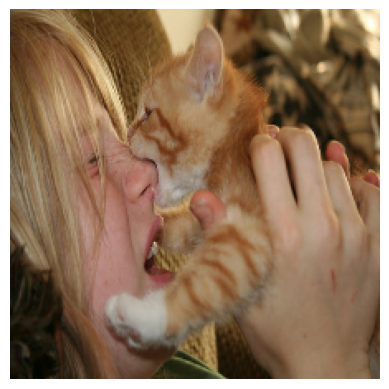

Predicted Caption: a girl is smiling at a camera
Groundtruth Caption:
A blonde child is being bitten on the nose by a little orange kitten .
A cat bites a human 's nose .
An orange striped kitten is biting a girl on the nose .
A orange kitten biting the nose of a child .
Orange striped kitten biting blonde girl on the nose
BLEU score:
BLEU-1: 0.5714
BLEU-2: 0.3086
BLEU-3: 0.1240
BLEU-4: 0.0831
METEOR score: 0.1639


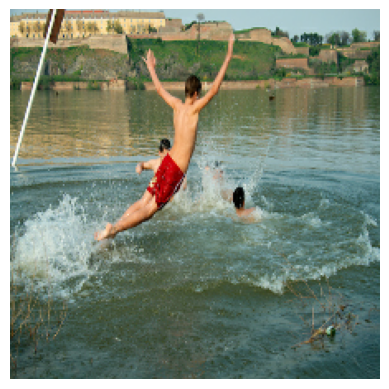

Predicted Caption: a boy in a red shirt is jumping into a lake
Groundtruth Caption:
A boy in a red suit plays in the water .
A boy in a red swimsuit jumps into the water to join two people .
A boy takes a flying leap into the water .
The boy in the red shorts jumps into the water to join other people .
The boy wearing red shorts is jumping into the river as other children swim .
BLEU score:
BLEU-1: 0.7273
BLEU-2: 0.6606
BLEU-3: 0.5788
BLEU-4: 0.4692
METEOR score: 0.4178


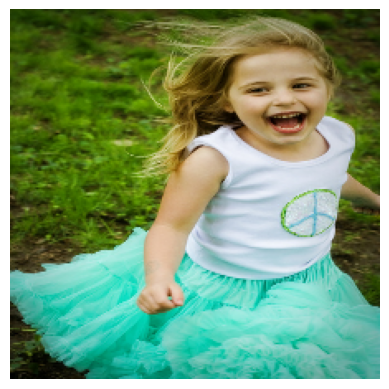

Predicted Caption: a girl in a pink dress is playing in a pool
Groundtruth Caption:
A young girl is in a teal colored netted skirt and wearing a shirt with a peace sign .
A young girl smiles while wearing a teal fluffy skirt .
a young girl wearing blue smiles .
The little girl is running and laughing .
The little girl is wearing a white T-shirt with a peace sign and a sea foam green tutu .
BLEU score:
BLEU-1: 0.5455
BLEU-2: 0.2335
BLEU-3: 0.0846
BLEU-4: 0.0525
METEOR score: 0.3453


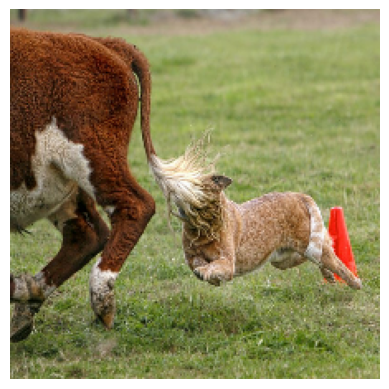

Predicted Caption: a dog is running through a field
Groundtruth Caption:
A dog biting the tail of a cow .
A dog chasing an animals tail on the grass .
A small animal leaps behind a larger animal , the larger animal 's tail obscuring the smaller one 's face .
A small dog chases after a large brown cow .
A tan animal is being swatted in the face by a brown and white bull .
BLEU score:
BLEU-1: 0.4954
BLEU-2: 0.2675
BLEU-3: 0.1075
BLEU-4: 0.0720
METEOR score: 0.3235


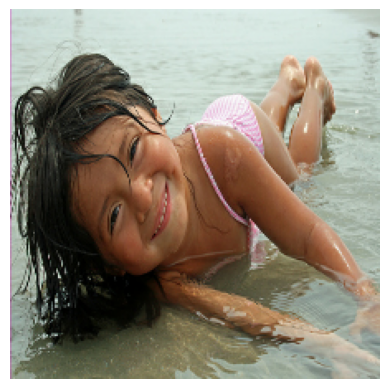

Predicted Caption: a girl is playing in the water
Groundtruth Caption:
A closeup of a young child wearing a pink bathing suit laying in shallow water at the beach .
A little girl smiles as she lays on her side in the water .
a smiling toddler in a pink swimsuit is laying in the water .
A young dark haired girl in a pink and white swimsuit smiles as she lies in three inch deep water .
Little girl in swimsuit lies on stomach in water , smiles at camera .
BLEU score:
BLEU-1: 0.4196
BLEU-2: 0.2617
BLEU-3: 0.1886
BLEU-4: 0.0952
METEOR score: 0.3878


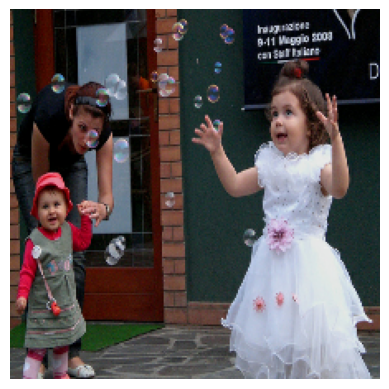

Predicted Caption: a girl in a pink dress is standing in front of a building
Groundtruth Caption:
A girl in a white dress is playing with bubbles while a mother and daughter stand to the side .
A woman stands with two young girls in dresses looking at bubbles .
A young girl in a white dress watches bubbles while a woman and girl toddler observe .
Two girls looking at bubbles in the air .
Two little girls and an adult watch bubbles float through the air in front of them .
BLEU score:
BLEU-1: 0.6923
BLEU-2: 0.5883
BLEU-3: 0.4553
BLEU-4: 0.3117
METEOR score: 0.3431


In [ ]:
for i in range(50):
    generate_caption(np.random.choice(test_paths), test_raw)

## Caculate BLEU score

In [ ]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from tqdm import tqdm
import numpy as np

def eval_bleu_score(model, data, image_paths):
    score = np.zeros(4)
    smooth = SmoothingFunction()

    for i in tqdm(range(len(data))):
        # Read the image from the disk
        image = load_image(image_paths[i])
        image = image.numpy().clip(0, 255).astype(np.uint8)

        # Generate the caption
        result_txt = model.simple_gen(image, temperature=0.0)

        # Calculate the BLEU score
        true_captions = get_captions(image_paths[i], data)
        score += sentence_bleu(split_caption(true_captions), result_txt.split(' '),
                          weights=([1],[1/2,1/2], [1/3,1/3,1/3], [1/4,1/4,1/4,1/4]),
                          smoothing_function=smooth.method1)
    score /= len(data)
    return score

In [ ]:
score_bleu = eval_bleu_score(new_model, train_raw, train_paths)
print("\nBLEU score:")
print(f"BLEU-1: {score_bleu[0]:.4f}")
print(f"BLEU-2: {score_bleu[1]:.4f}")
print(f"BLEU-3: {score_bleu[2]:.4f}")
print(f"BLEU-4: {score_bleu[3]:.4f}")

In [ ]:
score_bleu = eval_bleu_score(new_model, test_raw, test_paths)
print("\nBLEU score:")
print(f"BLEU-1: {score_bleu[0]:.4f}")
print(f"BLEU-2: {score_bleu[1]:.4f}")
print(f"BLEU-3: {score_bleu[2]:.4f}")
print(f"BLEU-4: {score_bleu[3]:.4f}")

## Caculate METEOR score

In [ ]:
from nltk.translate.meteor_score import meteor_score
from tqdm import tqdm
import numpy as np

def eval_meteor_score(model, data, image_paths):
    score = 0

    for i in tqdm(range(0, len(data))):
        # Read the image from the disk
        image = load_image(image_paths[i])
        image = image.numpy().clip(0, 255).astype(np.uint8)

        # Generate the caption
        result_txt = model.simple_gen(image, temperature=0.0)

        # Calculate the BLEU score
        true_captions = get_captions(image_paths[i], data)
        score += meteor_score(split_caption(true_captions), result_txt.split(' '))
    score /= len(data)
    return score

In [ ]:
score_meteor = eval_meteor_score(new_model, train_raw, train_paths)
print(f"\nMETEOR score: {score_meteor:.4f}")

In [ ]:
score_meteor = eval_meteor_score(new_model, test_raw, test_paths)
print(f"\nMETEOR score: {score_meteor:.4f}")